<a href="https://colab.research.google.com/github/Ketan-Kapse/PneumoniaTypeClassifier/blob/main/BACTERIAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')          

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/Bact_data

/content/drive/.shortcut-targets-by-id/1l5l5KExdsD_MDe-Y-DrxmbhOnHj8y7Cv/Bact_data


In [ ]:
%pip install tensorboard
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
import tensorflow as tf     
import keras                                        
import numpy as np                                                  
import argparse
import cv2
import os, datetime                                                
import matplotlib.pyplot as plt

from PIL import Image
from glob import glob

from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator                          
from tensorflow.keras.layers import AveragePooling2D, Dropout,Flatten, Dense                 # Importing Custom Layers. 
from tensorflow.keras.applications import VGG19, resnet50                                    # Importing ResNet50 Architecture
from tensorflow.keras.applications.resnet import preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam                                                 # Importing Adam Optimizer
from tensorflow.keras.callbacks import ReduceLROnPlateau, TensorBoard                                     # This reduces the Learning Rate (LR) whenever the loss doesn't decrease or accuracy doesn't increase over a few epochs

In [ ]:
image_size = [224, 224]                                                                      # Setting a universal uniform resolution for dataset images

train = 'train'
test = 'test'
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
logdir = os.path.join("/logs/", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
res = tf.keras.applications.VGG19(                                                      # 'res' will act like a history variable and can be used for graphing
    input_shape=image_size + [3],                                                            # '[3]' denotes the number of channels the dataset images have currently
    weights='imagenet',                                                                     
    include_top=False)                                                                       # Removing the last output layer of resnet so that the net can be attached to the layers defined below.

In [ ]:
folders = glob('train/*')
len(folders)

2

In [ ]:
pooling=AveragePooling2D(pool_size=(2,2))(res.output)                                        # Kernel size is 4,4, default size. No changes needed.
flat = Flatten()(pooling)
dense1 = Dense(128, activation = 'relu')(flat)                                                    # Dense layer size followed according to a research paper. Need to check which. Rectified Linear Unit as the activation function. Very standard.
dense2 = Dense(256, activation = 'relu')(dense1)
dense3 = Dense(512, activation ='relu')(dense2)
dropout2=Dropout(0.2)(dense3)
dense4 = Dense(256, activation ='relu')(dropout2)                                                                # Randomly dropping inputs from 'dense2' to 0 to avoid overfitting. Scaling of other inputs = 1/ (1-Rate). Rate is 0.5.
dense2=Dense(2,activation='softmax')(dense4)                                               # Size is 2 because of the number of outputs we have for this CNN is 2. Softmax default activation fn for last dense layer.

model=Model(inputs=res.input,outputs=dense2)

In [ ]:
for layer in res.layers:
    layer.trainable = False                                                                  # Freezing the ResNet Layers to avoid retraining them and retain original paramenters

In [ ]:
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [ ]:
len(model.layers)

30

In [ ]:
model.compile(
  loss='categorical_crossentropy',                                                 # Loss Function is Categorical CrossEntropy because we have two labelled classes (bacterial and normal). Could use binary_crossentropy as well.
  optimizer=Adam(learning_rate=0.001),
  metrics=['accuracy']
)

In [ ]:
train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.05,
                                   zoom_range = 0.05,
                                   width_shift_range=0.1,
                                   height_shift_range=0.1,
                                   horizontal_flip = True,
                                   rotation_range=15,
                                   fill_mode="nearest")

test_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:
training_set = train_datagen.flow_from_directory(train,
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode='categorical')
training_set.class_indices


Found 3871 images belonging to 2 classes.


{'NORMAL': 0, 'PNEUMONIA': 1}

In [ ]:
test_set = test_datagen.flow_from_directory(test,
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode='categorical',
                                            shuffle = False)
test_set.class_indices

Found 476 images belonging to 2 classes.


{'NORMAL': 0, 'PNEUMONIA': 1}

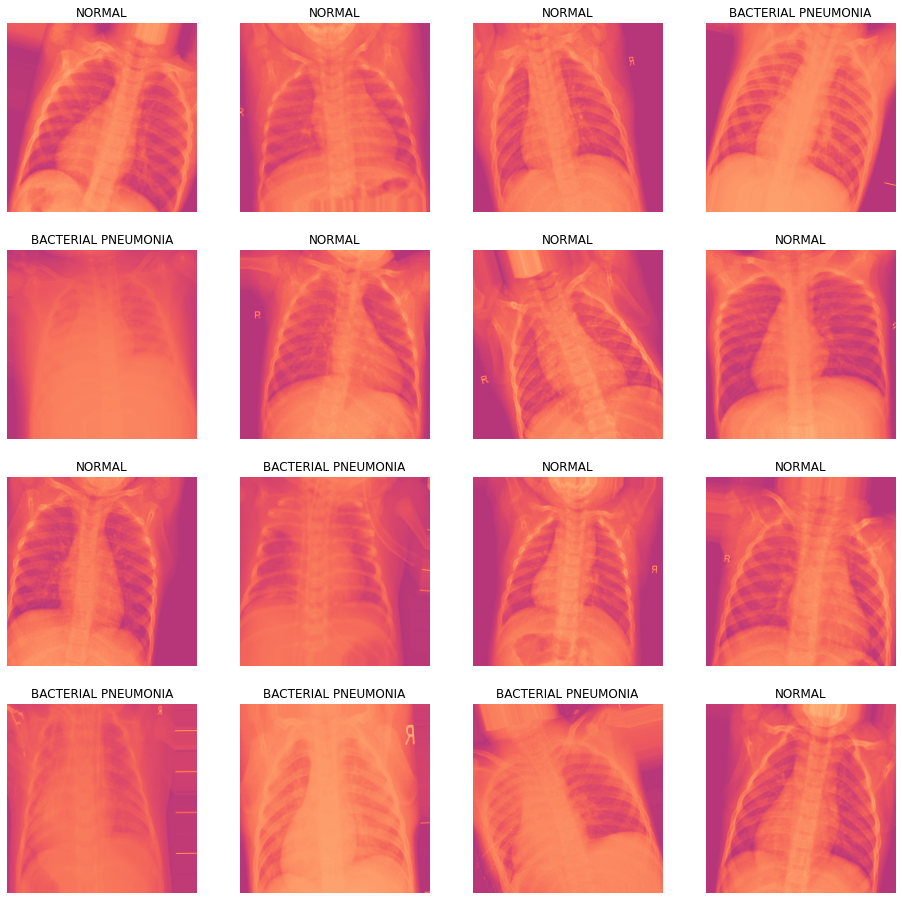

In [ ]:
all_labels = ['NORMAL', 'BACTERIAL PNEUMONIA',]
t_x, t_y = next(training_set)
fig, m_axs = plt.subplots(4, 4, figsize = (16, 16))
for (c_x, c_y, c_ax) in zip(t_x, t_y, m_axs.flatten()):
    c_ax.imshow(c_x[:,:,0], cmap= 'magma', vmin = -1.5, vmax = 1.5)            #look up cmap colours
    c_ax.set_title(', '.join([n_class for n_class, n_score in zip(all_labels, c_y) 
                             if n_score>0.5]))
    c_ax.axis('off')

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='accuracy', factor=0.2,
                              patience=3, verbose=1, cooldown=3, mode='auto', min_delta=0.01)
callbacks = [TensorBoard(log_dir=logdir,
                         histogram_freq=1,
                         write_graph=True,
                         write_images=True,
                         update_freq='epoch',
                         profile_batch=2,
                         embeddings_freq=1)]
checkpoint= tf.keras.callbacks.ModelCheckpoint(
    filepath='/outp3',
    monitor='accuracy',
    verbose=1,
    save_best_only=True,
    save_weights_only=False,
    mode="auto",
    save_freq="epoch",
    options=None
)

In [ ]:
tf.keras.backend.set_learning_phase(1)
history = model.fit(
  training_set,
  validation_data=test_set,
  epochs=10,
  steps_per_epoch=119,     # len(train)//batchsize
  validation_steps=13,
  callbacks=[reduce_lr, callbacks, checkpoint]
  
)

/usr/local/lib/python3.7/dist-packages/keras/backend.py:450: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


Epoch 1/10
119/119 [==============================] - ETA: 0s - loss: 0.2805 - accuracy: 0.8805
Epoch 1: accuracy improved from -inf to 0.88048, saving model to /outp3
INFO:tensorflow:Assets written to: /outp3/assets
119/119 [==============================] - 878s 7s/step - loss: 0.2805 - accuracy: 0.8805 - val_loss: 0.2738 - val_accuracy: 0.8942 - lr: 0.0010
Epoch 2/10
119/119 [==============================] - ETA: 0s - loss: 0.1487 - accuracy: 0.9454
Epoch 2: accuracy improved from 0.88048 to 0.94536, saving model to /outp3
INFO:tensorflow:Assets written to: /outp3/assets
119/119 [==============================] - 132s 1s/step - loss: 0.1487 - accuracy: 0.9454 - val_loss: 0.2564 - val_accuracy: 0.8870 - lr: 0.0010
Epoch 3/10
119/119 [==============================] - ETA: 0s - loss: 0.1304 - accuracy: 0.9498
Epoch 3: accuracy improved from 0.94536 to 0.94983, saving model to /outp3
INFO:tensorflow:Assets written to: /outp3/assets
119/119 [==============================] - 125s 1s/st

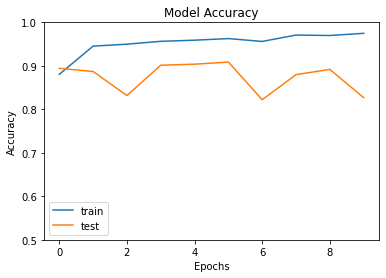

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'test'])
plt.ylim([0.5,1])
plt.show()

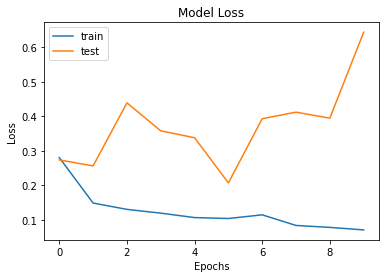

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'test'])
#plt.ylim(0.0,)
plt.show()

In [ ]:
#model.save('saved_model/bacterial_normal.h5', save_format='h5')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  """Entry point for launching an IPython kernel.


10/10 [==============================] - 6s 493ms/step
Predictions finished
prob:[0.9339016  0.06609832]
NORMAL/IM-0001-0001.jpeg


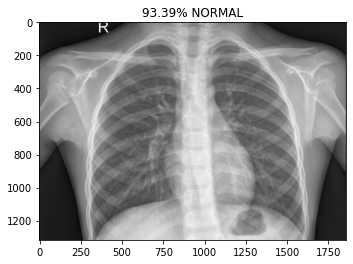

prob:[0.99164337 0.00835655]
NORMAL/IM-0003-0001.jpeg


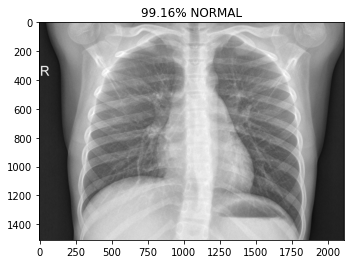

prob:[0.99201983 0.00798017]
NORMAL/IM-0005-0001.jpeg


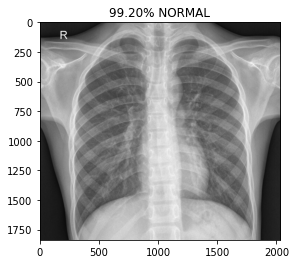

prob:[0.96417946 0.03582053]
NORMAL/IM-0006-0001.jpeg


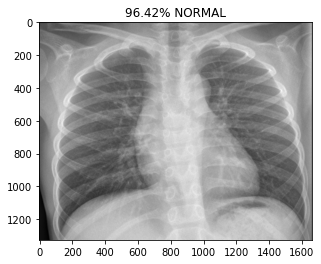

prob:[0.9819411  0.01805894]
NORMAL/IM-0007-0001.jpeg


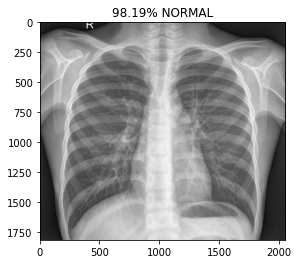

prob:[0.99814653 0.00185345]
NORMAL/IM-0009-0001.jpeg


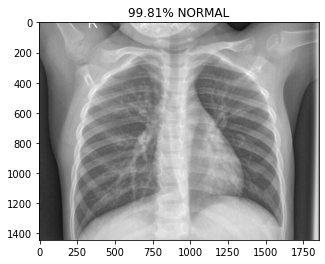

prob:[0.99073315 0.00926687]
NORMAL/IM-0010-0001.jpeg


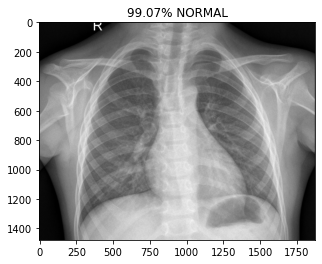

prob:[0.8434384  0.15656158]
NORMAL/IM-0011-0001-0001.jpeg


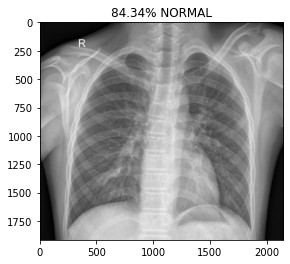

prob:[0.78319025 0.2168098 ]
NORMAL/IM-0011-0001-0002.jpeg


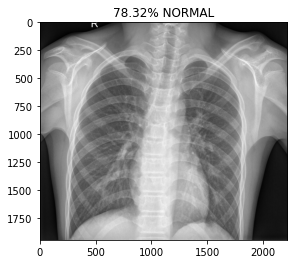

prob:[0.9837097  0.01629033]
NORMAL/IM-0011-0001.jpeg


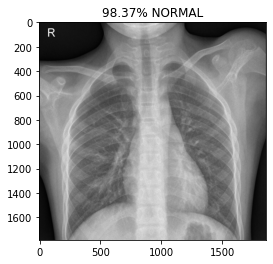

prob:[0.998637   0.00136294]
NORMAL/IM-0013-0001.jpeg


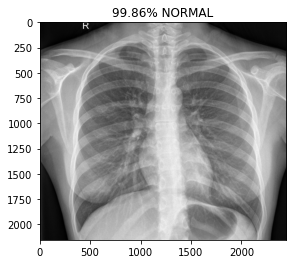

prob:[0.9212575  0.07874253]
NORMAL/IM-0015-0001.jpeg


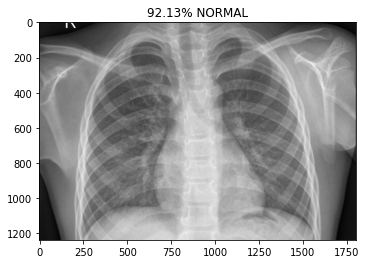

prob:[0.99874914 0.00125086]
NORMAL/IM-0016-0001.jpeg


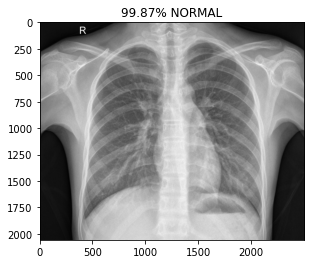

prob:[0.99461293 0.00538711]
NORMAL/IM-0017-0001.jpeg


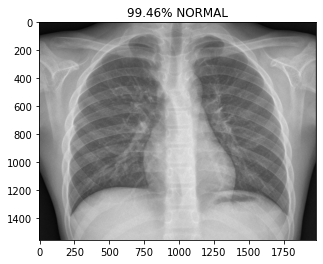

prob:[0.83340436 0.16659564]
NORMAL/IM-0019-0001.jpeg


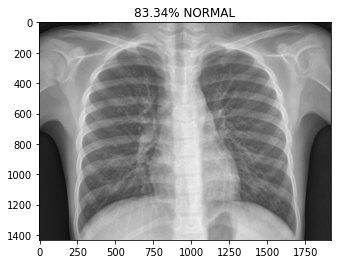

prob:[0.90457034 0.09542964]
NORMAL/IM-0021-0001.jpeg


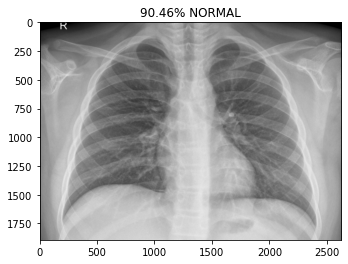

prob:[2.4248702e-04 9.9975747e-01]
NORMAL/IM-0022-0001.jpeg


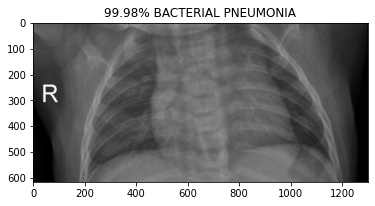

prob:[0.98667926 0.01332068]
NORMAL/IM-0023-0001.jpeg


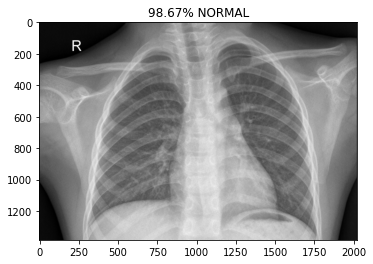

prob:[0.9976472  0.00235281]
NORMAL/IM-0025-0001.jpeg


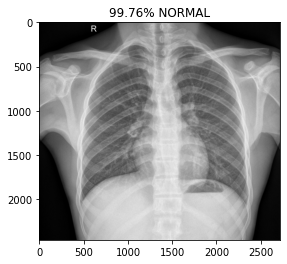

prob:[0.9824598  0.01754028]
NORMAL/IM-0027-0001.jpeg


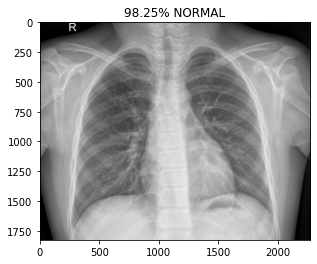

prob:[0.9075     0.09249996]
NORMAL/IM-0028-0001.jpeg


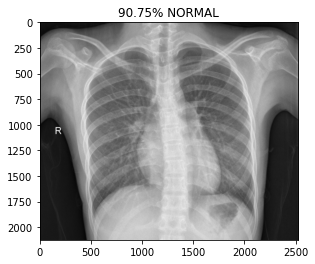

prob:[0.99694115 0.00305887]
NORMAL/IM-0029-0001.jpeg


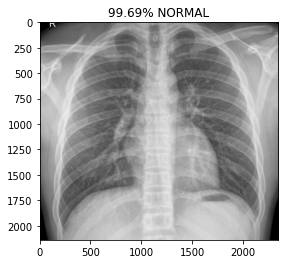

prob:[0.893056   0.10694404]
NORMAL/IM-0030-0001.jpeg


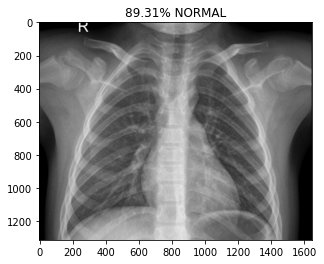

prob:[0.88566947 0.11433049]
NORMAL/IM-0031-0001.jpeg


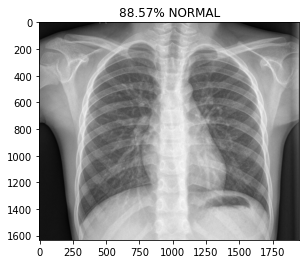

prob:[0.98026294 0.01973703]
NORMAL/IM-0033-0001-0001.jpeg


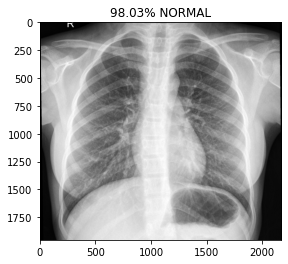

prob:[0.99873096 0.00126909]
NORMAL/IM-0033-0001-0002.jpeg


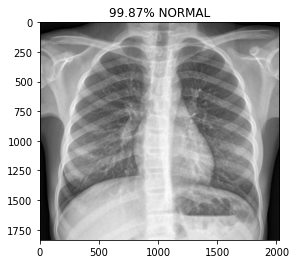

prob:[0.9889205 0.0110795]
NORMAL/IM-0033-0001.jpeg


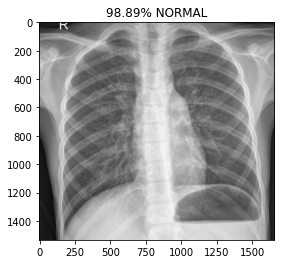

prob:[0.99735653 0.00264348]
NORMAL/IM-0035-0001.jpeg


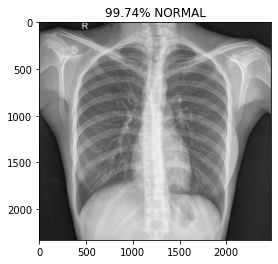

prob:[0.9821654  0.01783462]
NORMAL/IM-0036-0001.jpeg


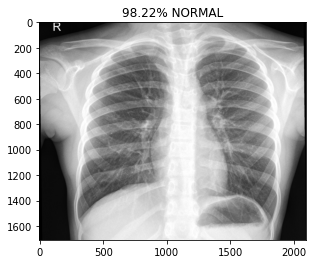

prob:[0.8489313  0.15106872]
NORMAL/IM-0037-0001.jpeg


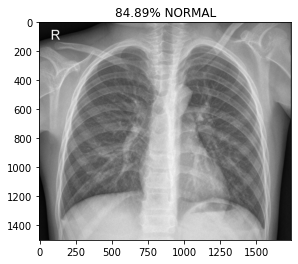

prob:[0.49494916 0.5050508 ]
NORMAL/IM-0039-0001.jpeg


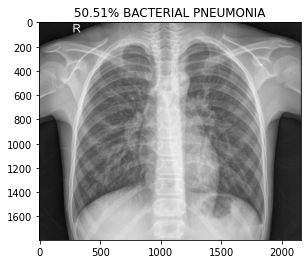

prob:[0.9537503  0.04624971]
NORMAL/IM-0041-0001.jpeg


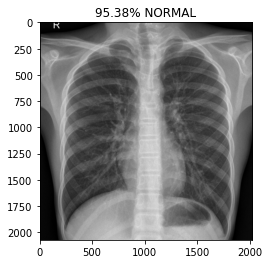

prob:[0.9945094  0.00549063]
NORMAL/IM-0043-0001.jpeg


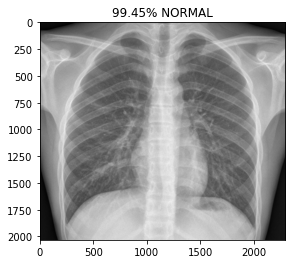

prob:[9.990221e-01 9.779253e-04]
NORMAL/IM-0045-0001.jpeg


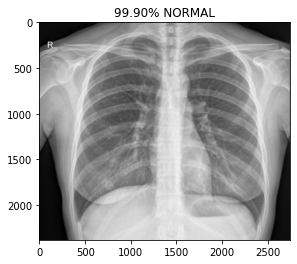

prob:[0.9466099  0.05339012]
NORMAL/IM-0046-0001.jpeg


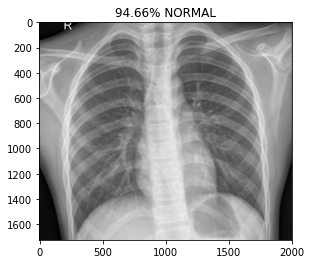

prob:[0.90467703 0.09532294]
NORMAL/IM-0049-0001.jpeg


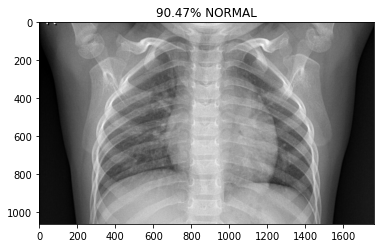

prob:[9.9917716e-01 8.2276255e-04]
NORMAL/IM-0050-0001.jpeg


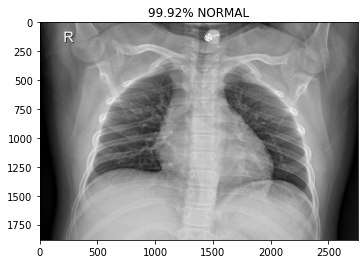

prob:[0.99355114 0.00644881]
NORMAL/IM-0059-0001.jpeg


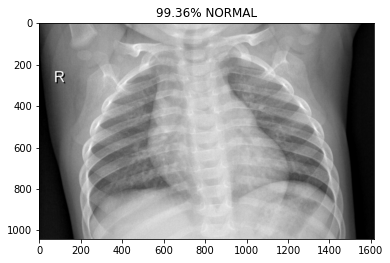

prob:[0.95476574 0.04523422]
NORMAL/IM-0061-0001.jpeg


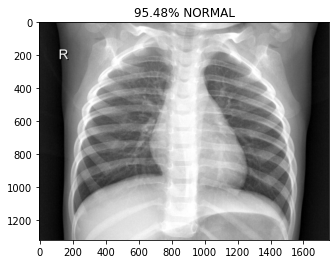

prob:[9.9945205e-01 5.4789509e-04]
NORMAL/IM-0063-0001.jpeg


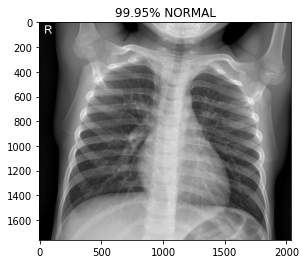

prob:[0.12953322 0.87046677]
NORMAL/IM-0065-0001.jpeg


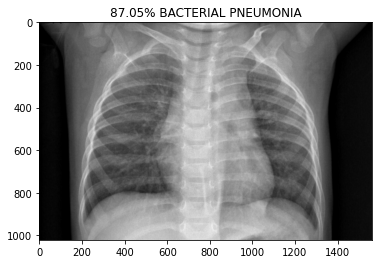

prob:[0.9863941  0.01360592]
NORMAL/IM-0067-0001.jpeg


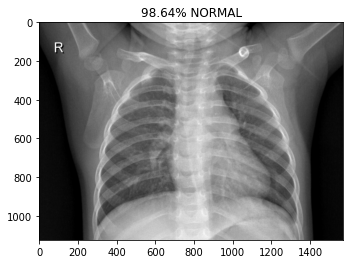

prob:[0.8670998 0.1329002]
NORMAL/IM-0069-0001.jpeg


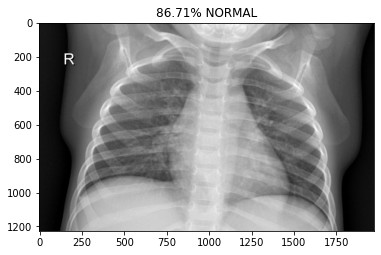

prob:[9.9935716e-01 6.4282853e-04]
NORMAL/IM-0070-0001.jpeg


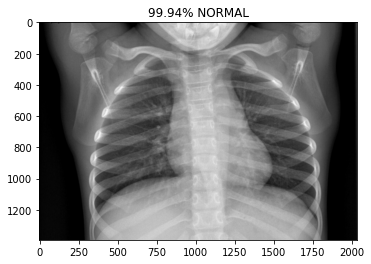

prob:[0.92639923 0.07360074]
NORMAL/IM-0071-0001.jpeg


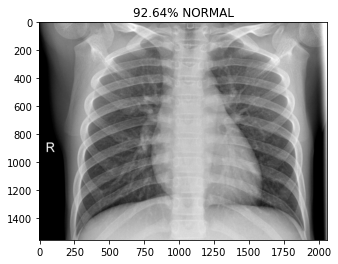

prob:[0.03989242 0.9601076 ]
NORMAL/IM-0073-0001.jpeg


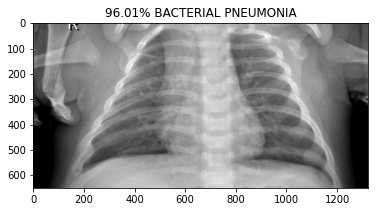

prob:[0.45133534 0.5486647 ]
NORMAL/IM-0075-0001.jpeg


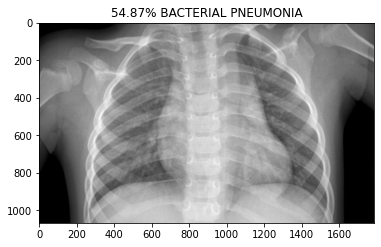

prob:[0.86817    0.13182995]
NORMAL/IM-0077-0001.jpeg


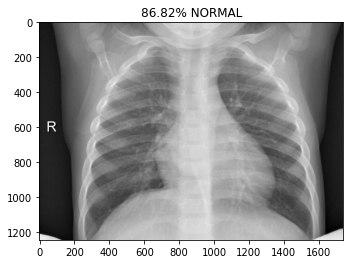

prob:[0.9302413  0.06975868]
NORMAL/IM-0079-0001.jpeg


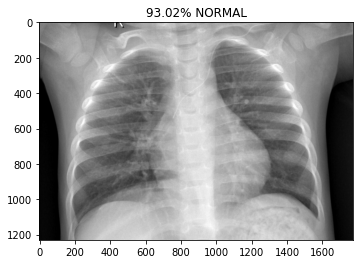

prob:[0.18106963 0.8189303 ]
NORMAL/IM-0081-0001.jpeg


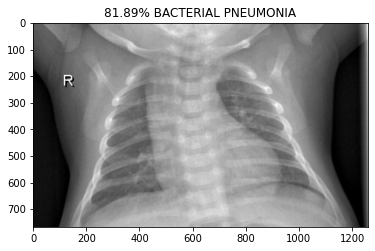

prob:[0.93312126 0.06687871]
NORMAL/IM-0083-0001.jpeg


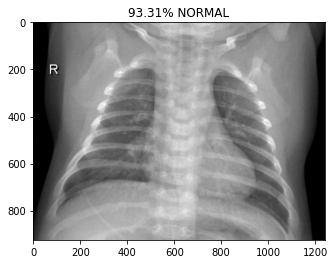

prob:[0.54838556 0.45161447]
NORMAL/IM-0084-0001.jpeg


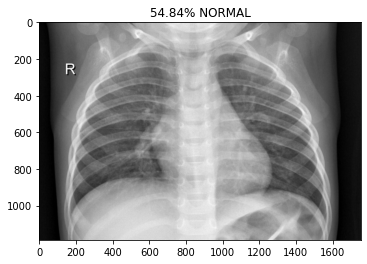

prob:[0.44779432 0.55220574]
NORMAL/IM-0085-0001.jpeg


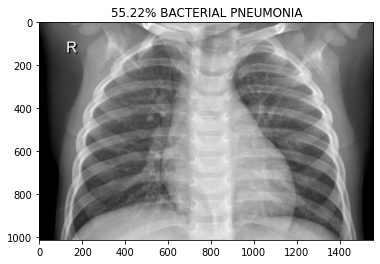

prob:[0.99492407 0.0050759 ]
NORMAL/IM-0086-0001.jpeg


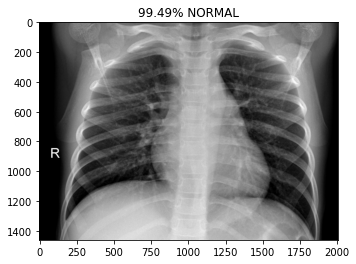

prob:[0.94232625 0.05767372]
NORMAL/IM-0087-0001.jpeg


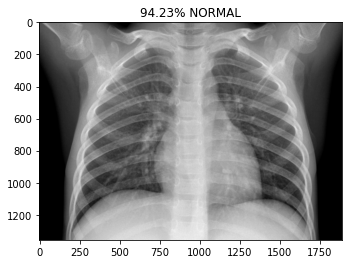

prob:[0.9955664  0.00443354]
NORMAL/IM-0089-0001.jpeg


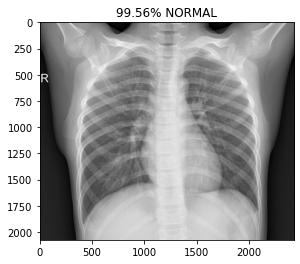

prob:[0.27322686 0.72677314]
NORMAL/IM-0091-0001.jpeg


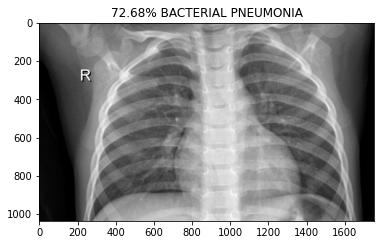

prob:[0.99465203 0.00534798]
NORMAL/IM-0093-0001.jpeg


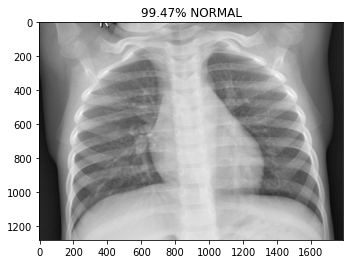

prob:[0.9929206  0.00707943]
NORMAL/IM-0095-0001.jpeg


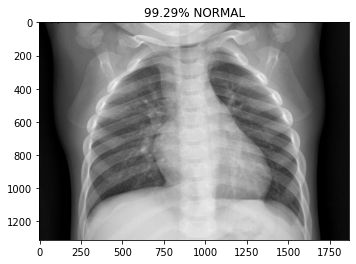

prob:[0.7901484 0.2098516]
NORMAL/IM-0097-0001.jpeg


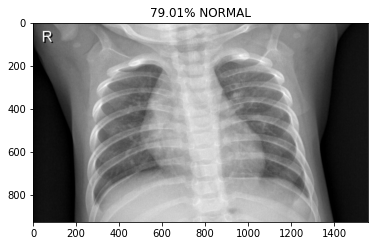

prob:[0.99743575 0.00256428]
NORMAL/IM-0099-0001.jpeg


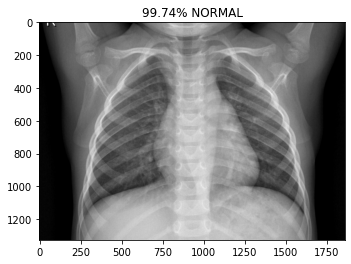

prob:[0.7915714  0.20842862]
NORMAL/IM-0101-0001.jpeg


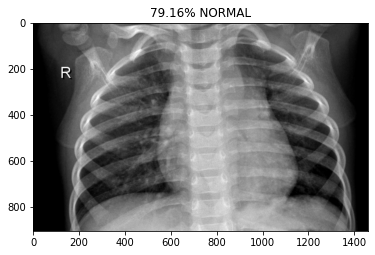

prob:[0.78925204 0.21074796]
NORMAL/IM-0102-0001.jpeg


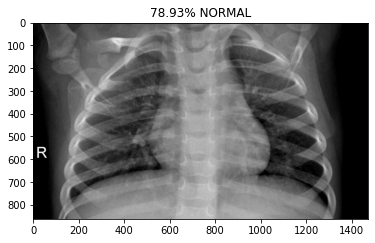

prob:[9.9994564e-01 5.4356042e-05]
NORMAL/IM-0103-0001.jpeg


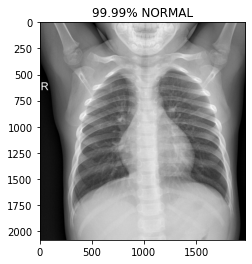

prob:[0.9625604  0.03743964]
NORMAL/IM-0105-0001.jpeg


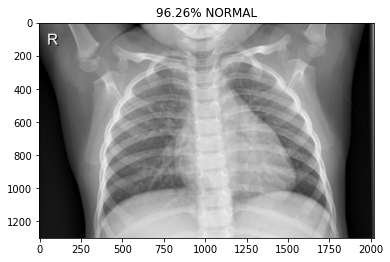

prob:[0.98949265 0.0105074 ]
NORMAL/IM-0107-0001.jpeg


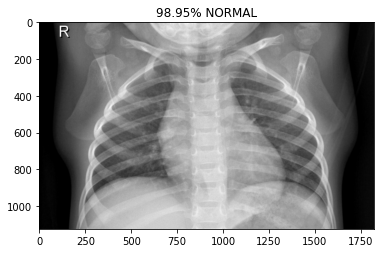

prob:[0.82836527 0.1716348 ]
NORMAL/IM-0109-0001.jpeg


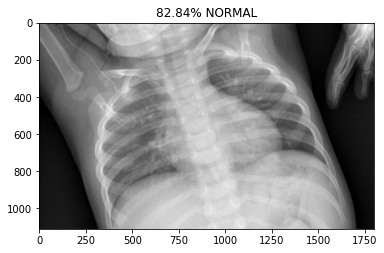

prob:[0.11284371 0.88715625]
NORMAL/IM-0110-0001.jpeg


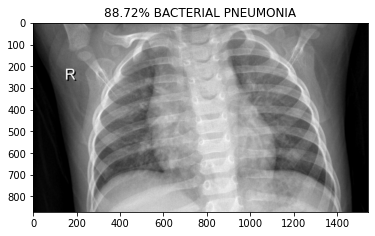

prob:[0.98373955 0.01626042]
NORMAL/IM-0111-0001.jpeg


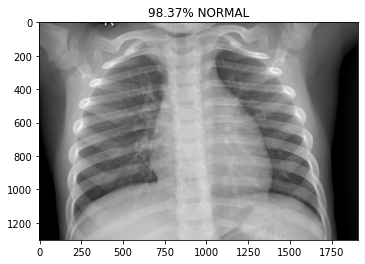

prob:[0.67412925 0.32587072]
NORMAL/NORMAL2-IM-0007-0001.jpeg


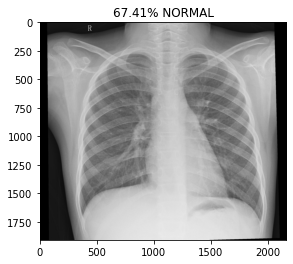

prob:[0.963164   0.03683607]
NORMAL/NORMAL2-IM-0012-0001.jpeg


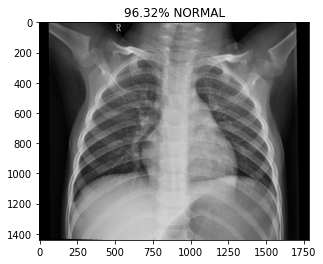

prob:[0.9966767  0.00332331]
NORMAL/NORMAL2-IM-0013-0001.jpeg


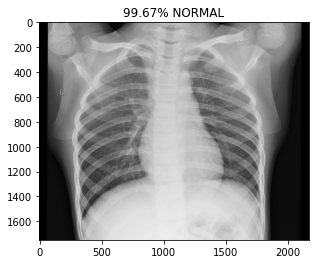

prob:[0.6743682  0.32563183]
NORMAL/NORMAL2-IM-0019-0001.jpeg


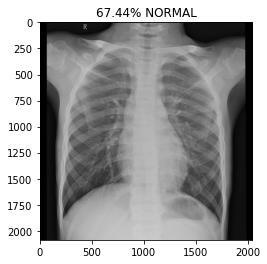

prob:[0.80105144 0.19894858]
NORMAL/NORMAL2-IM-0023-0001.jpeg


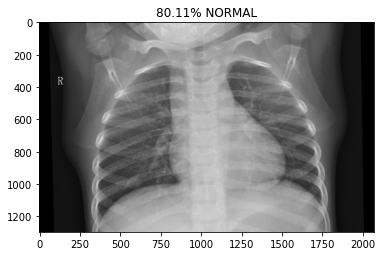

prob:[0.9653999  0.03460003]
NORMAL/NORMAL2-IM-0027-0001.jpeg


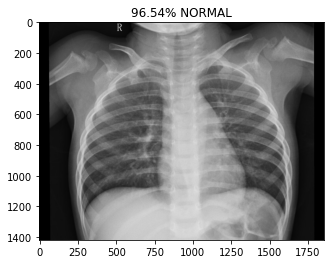

prob:[0.9396272  0.06037282]
NORMAL/NORMAL2-IM-0028-0001.jpeg


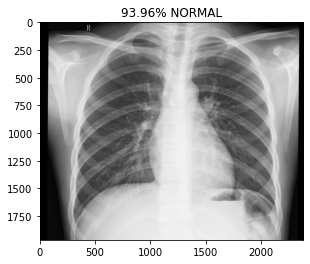

prob:[0.9972421  0.00275796]
NORMAL/NORMAL2-IM-0029-0001.jpeg


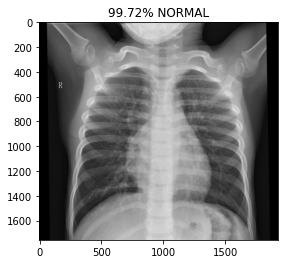

prob:[0.6201417  0.37985834]
NORMAL/NORMAL2-IM-0030-0001.jpeg


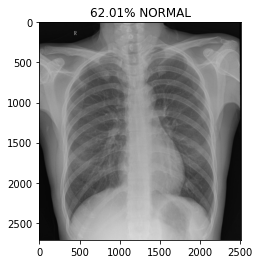

prob:[9.999236e-01 7.636681e-05]
NORMAL/NORMAL2-IM-0033-0001.jpeg


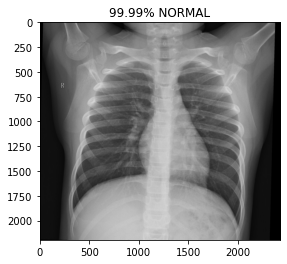

prob:[0.9967694  0.00323058]
NORMAL/NORMAL2-IM-0035-0001.jpeg


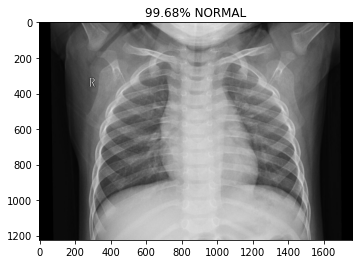

prob:[0.9817515  0.01824849]
NORMAL/NORMAL2-IM-0041-0001.jpeg


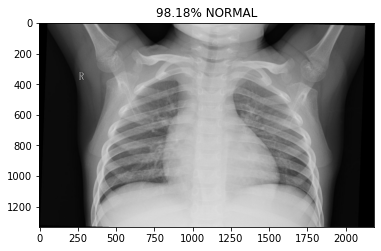

prob:[0.9165771  0.08342289]
NORMAL/NORMAL2-IM-0045-0001.jpeg


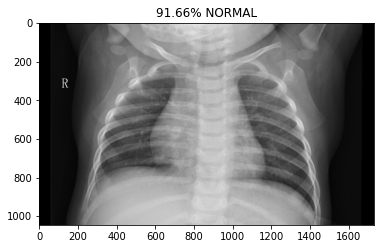

prob:[0.9123626  0.08763745]
NORMAL/NORMAL2-IM-0051-0001.jpeg


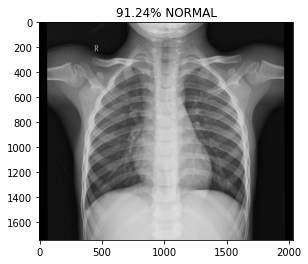

prob:[0.51791316 0.48208684]
NORMAL/NORMAL2-IM-0052-0001.jpeg


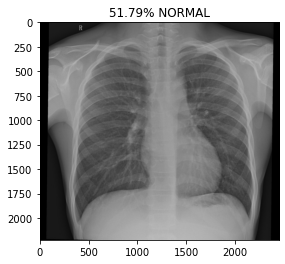

prob:[0.9884063  0.01159376]
NORMAL/NORMAL2-IM-0058-0001.jpeg


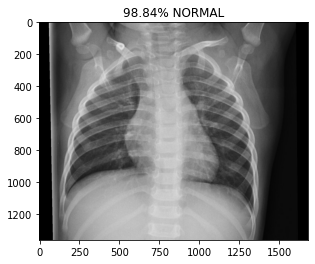

prob:[0.93452203 0.06547794]
NORMAL/NORMAL2-IM-0059-0001.jpeg


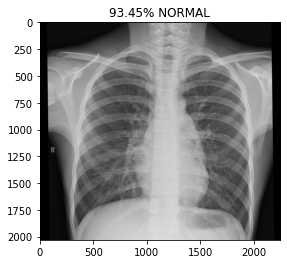

prob:[0.9978167  0.00218333]
NORMAL/NORMAL2-IM-0060-0001.jpeg


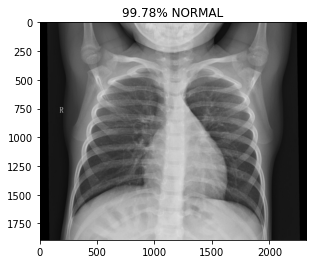

prob:[0.90822357 0.09177645]
NORMAL/NORMAL2-IM-0066-0001.jpeg


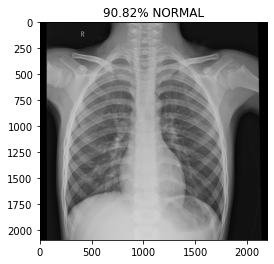

prob:[0.11581699 0.88418305]
NORMAL/NORMAL2-IM-0072-0001.jpeg


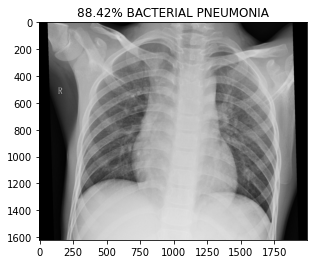

prob:[0.05692484 0.9430751 ]
NORMAL/NORMAL2-IM-0073-0001.jpeg


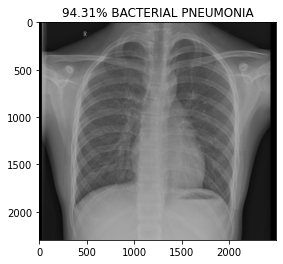

prob:[9.9965107e-01 3.4892943e-04]
NORMAL/NORMAL2-IM-0079-0001.jpeg


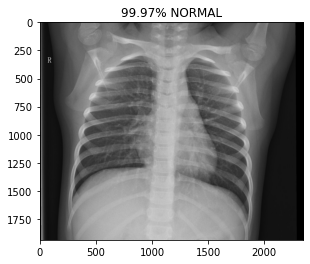

prob:[0.7833482  0.21665183]
NORMAL/NORMAL2-IM-0081-0001.jpeg


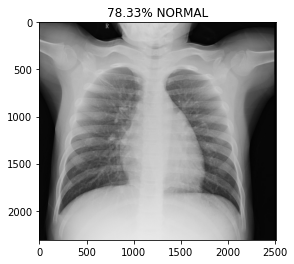

prob:[0.9856675  0.01433256]
NORMAL/NORMAL2-IM-0086-0001.jpeg


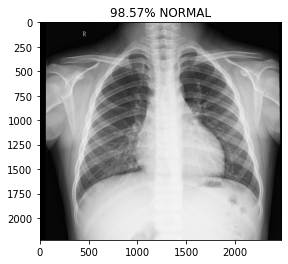

prob:[0.8840387  0.11596134]
NORMAL/NORMAL2-IM-0092-0001.jpeg


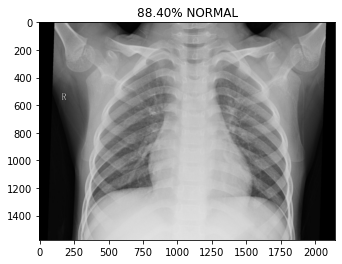

prob:[0.531487   0.46851304]
NORMAL/NORMAL2-IM-0095-0001.jpeg


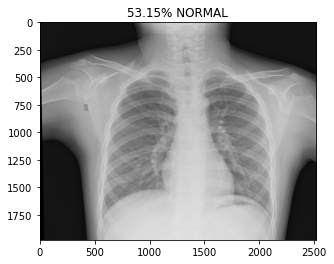

prob:[0.531487   0.46851304]
NORMAL/NORMAL2-IM-0096-0001.jpeg


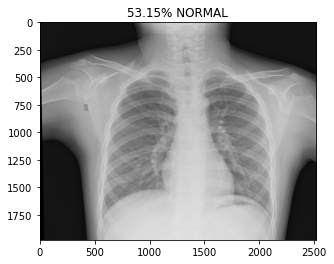

prob:[0.9933696 0.0066304]
NORMAL/NORMAL2-IM-0098-0001.jpeg


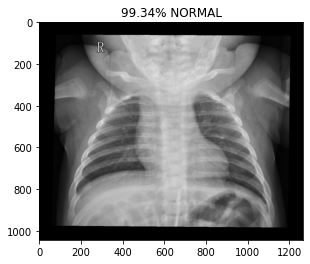

prob:[0.9910285  0.00897152]
NORMAL/NORMAL2-IM-0102-0001.jpeg


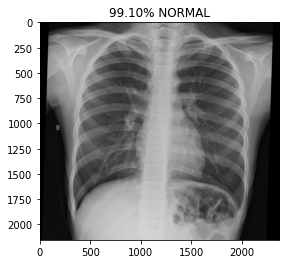

prob:[0.9195364  0.08046357]
NORMAL/NORMAL2-IM-0105-0001.jpeg


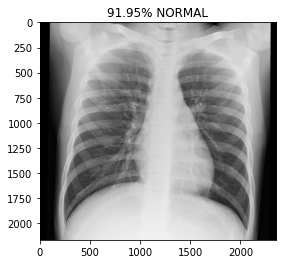

prob:[0.89676654 0.10323351]
NORMAL/NORMAL2-IM-0107-0001.jpeg


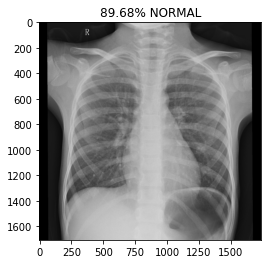

prob:[9.990263e-01 9.737215e-04]
NORMAL/NORMAL2-IM-0110-0001.jpeg


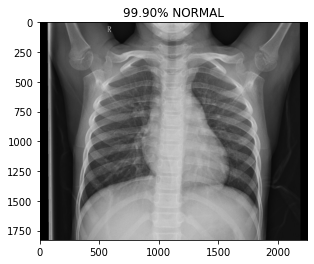

prob:[0.8735153 0.1264847]
NORMAL/NORMAL2-IM-0111-0001.jpeg


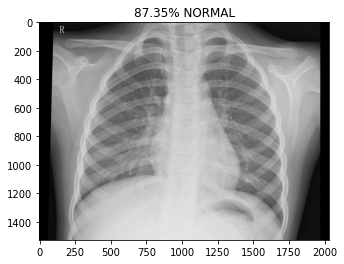

prob:[0.9928958  0.00710421]
NORMAL/NORMAL2-IM-0112-0001.jpeg


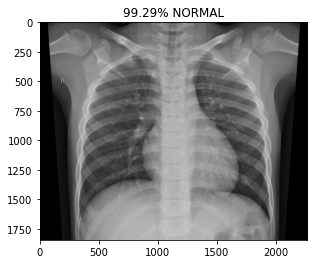

prob:[0.36605018 0.6339498 ]
NORMAL/NORMAL2-IM-0117-0001.jpeg


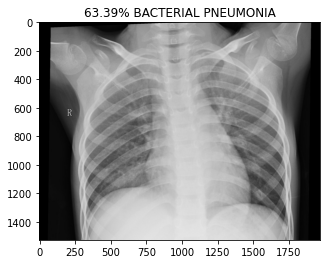

prob:[0.56144935 0.43855065]
NORMAL/NORMAL2-IM-0120-0001.jpeg


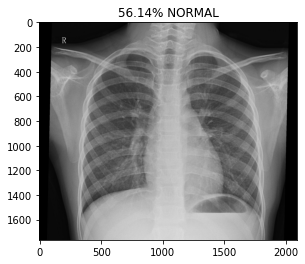

prob:[0.8504372  0.14956276]
NORMAL/NORMAL2-IM-0123-0001.jpeg


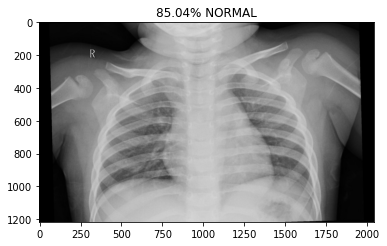

prob:[0.9911814  0.00881858]
NORMAL/NORMAL2-IM-0129-0001.jpeg


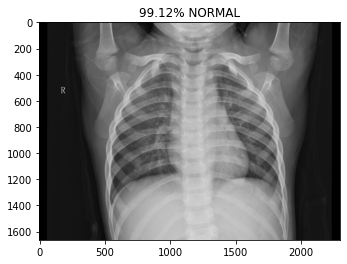

prob:[0.998251   0.00174897]
NORMAL/NORMAL2-IM-0130-0001.jpeg


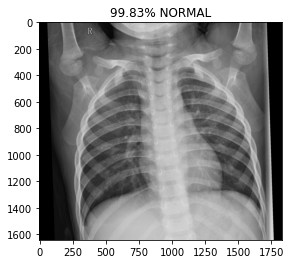

prob:[0.93893754 0.06106245]
NORMAL/NORMAL2-IM-0131-0001.jpeg


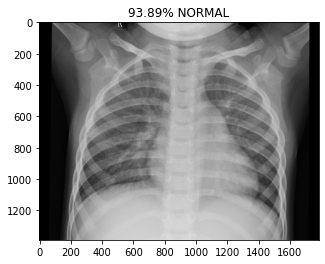

prob:[0.61882156 0.3811784 ]
NORMAL/NORMAL2-IM-0132-0001.jpeg


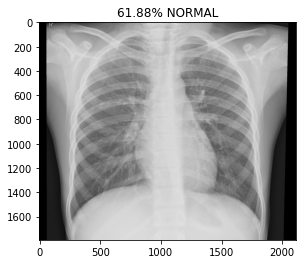

prob:[0.09313755 0.90686244]
NORMAL/NORMAL2-IM-0135-0001.jpeg


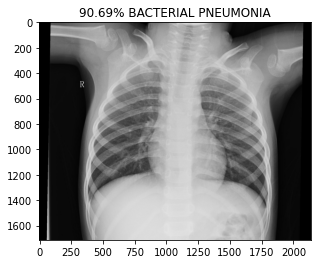

prob:[0.982249   0.01775094]
NORMAL/NORMAL2-IM-0139-0001.jpeg


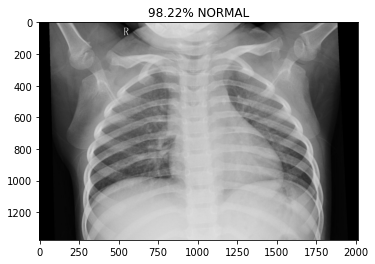

prob:[0.99823976 0.00176025]
NORMAL/NORMAL2-IM-0141-0001.jpeg


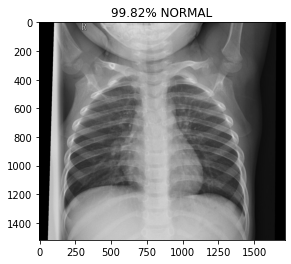

prob:[0.291501 0.708499]
NORMAL/NORMAL2-IM-0145-0001.jpeg


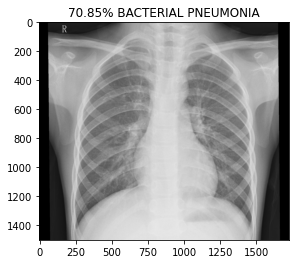

prob:[0.9406239  0.05937611]
NORMAL/NORMAL2-IM-0146-0001.jpeg


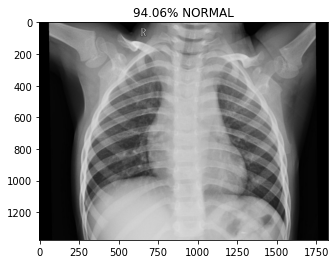

prob:[0.75693303 0.24306698]
NORMAL/NORMAL2-IM-0150-0001.jpeg


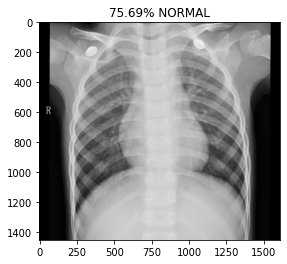

prob:[0.9508979  0.04910209]
NORMAL/NORMAL2-IM-0171-0001.jpeg


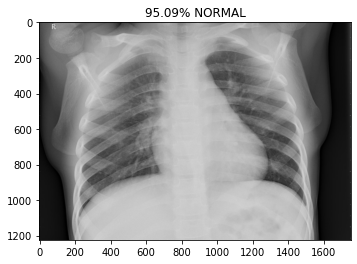

prob:[0.69534886 0.30465114]
NORMAL/NORMAL2-IM-0173-0001-0001.jpeg


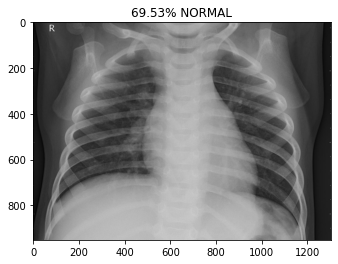

prob:[0.69534886 0.30465114]
NORMAL/NORMAL2-IM-0173-0001-0002.jpeg


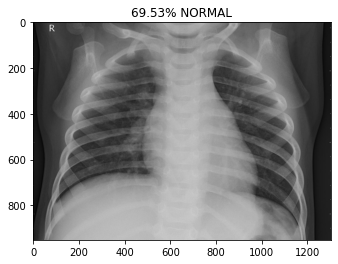

prob:[0.22311783 0.7768822 ]
NORMAL/NORMAL2-IM-0195-0001.jpeg


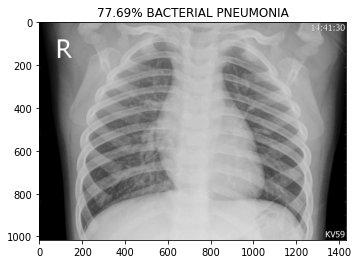

prob:[0.68849045 0.31150958]
NORMAL/NORMAL2-IM-0196-0001.jpeg


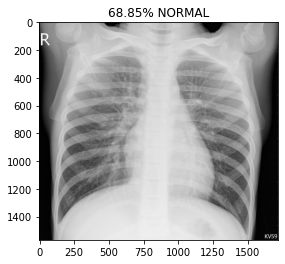

prob:[0.01310995 0.9868901 ]
NORMAL/NORMAL2-IM-0198-0001.jpeg


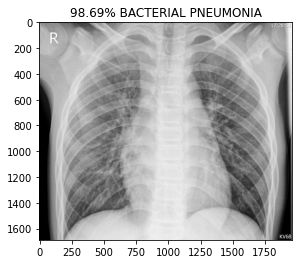

prob:[0.55384314 0.44615683]
NORMAL/NORMAL2-IM-0199-0001.jpeg


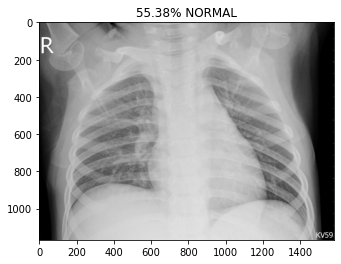

prob:[0.02527763 0.9747224 ]
NORMAL/NORMAL2-IM-0201-0001.jpeg


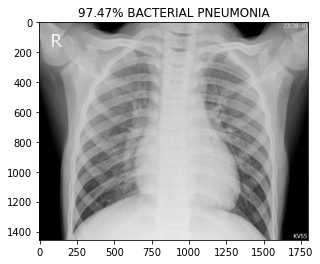

prob:[0.00293407 0.99706596]
NORMAL/NORMAL2-IM-0206-0001.jpeg


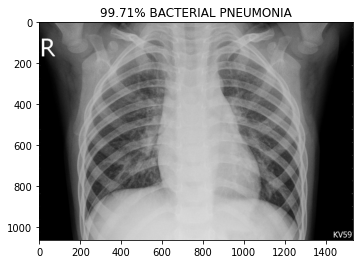

prob:[0.9888187  0.01118126]
NORMAL/NORMAL2-IM-0207-0001.jpeg


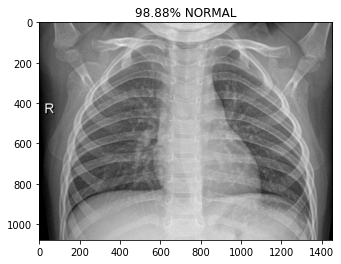

prob:[0.0017283 0.9982717]
NORMAL/NORMAL2-IM-0210-0001.jpeg


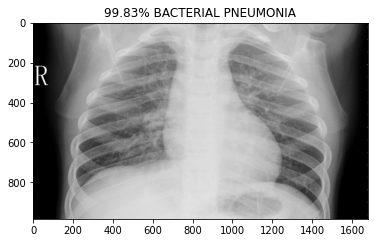

prob:[0.82896453 0.1710355 ]
NORMAL/NORMAL2-IM-0213-0001.jpeg


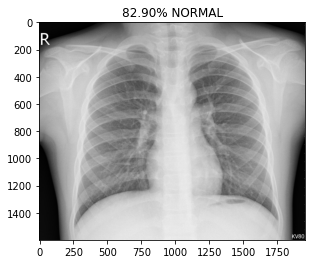

prob:[0.7667254  0.23327452]
NORMAL/NORMAL2-IM-0217-0001.jpeg


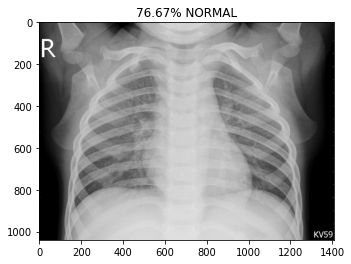

prob:[0.00107161 0.99892837]
NORMAL/NORMAL2-IM-0219-0001.jpeg


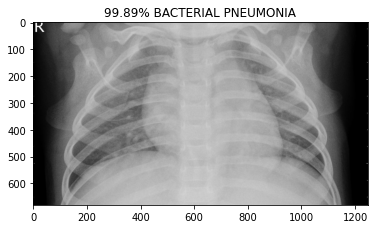

prob:[0.02305637 0.9769437 ]
NORMAL/NORMAL2-IM-0221-0001.jpeg


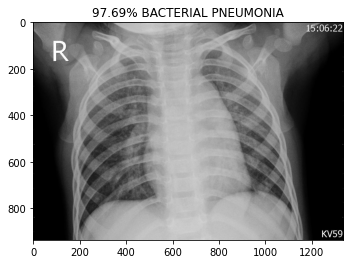

prob:[0.00668584 0.9933142 ]
NORMAL/NORMAL2-IM-0222-0001.jpeg


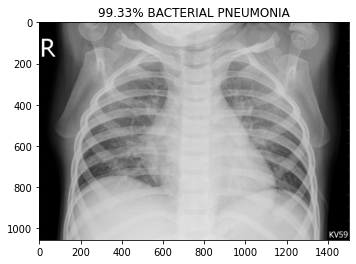

prob:[0.29800338 0.7019966 ]
NORMAL/NORMAL2-IM-0229-0001.jpeg


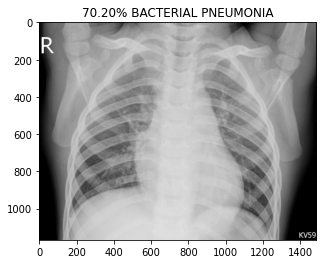

prob:[0.03531842 0.9646816 ]
NORMAL/NORMAL2-IM-0232-0001.jpeg


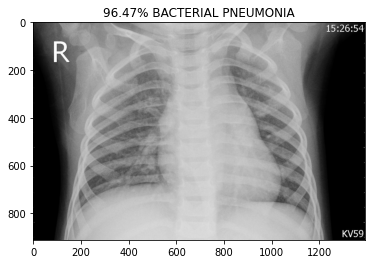

prob:[0.04971757 0.95028245]
NORMAL/NORMAL2-IM-0233-0001.jpeg


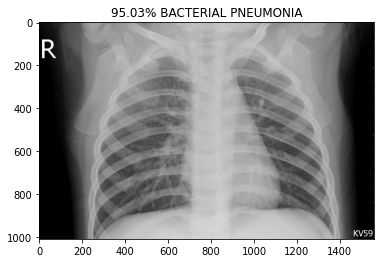

prob:[0.36261663 0.6373834 ]
NORMAL/NORMAL2-IM-0237-0001.jpeg


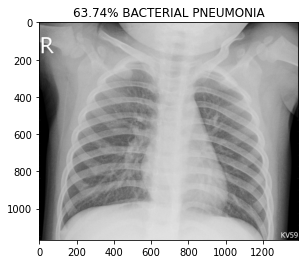

prob:[0.00810992 0.9918901 ]
NORMAL/NORMAL2-IM-0238-0001.jpeg


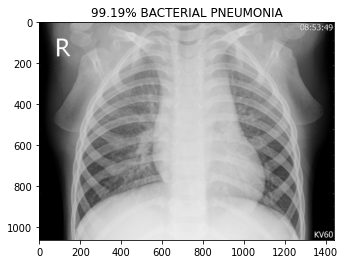

prob:[0.2681425  0.73185754]
NORMAL/NORMAL2-IM-0241-0001.jpeg


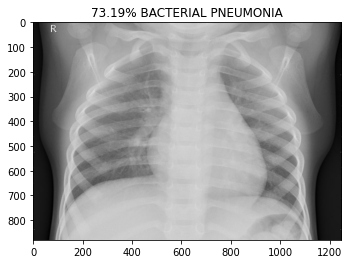

prob:[0.51084155 0.4891584 ]
NORMAL/NORMAL2-IM-0246-0001-0001.jpeg


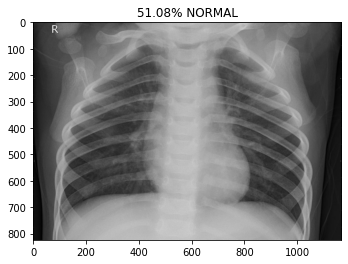

prob:[0.51084155 0.4891584 ]
NORMAL/NORMAL2-IM-0246-0001-0002.jpeg


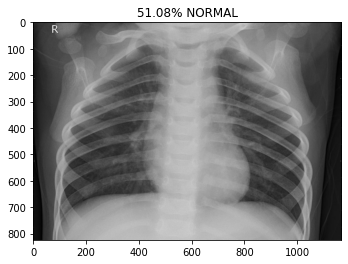

prob:[7.512401e-04 9.992487e-01]
NORMAL/NORMAL2-IM-0246-0001.jpeg


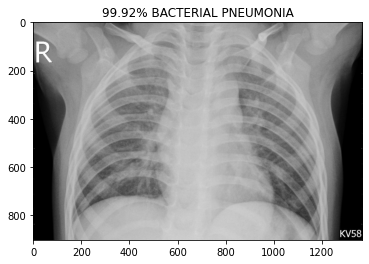

prob:[0.24686249 0.75313747]
NORMAL/NORMAL2-IM-0249-0001.jpeg


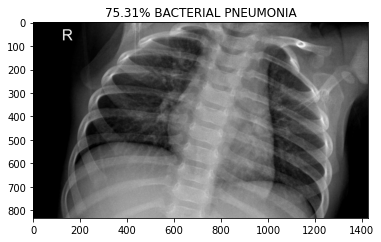

prob:[0.50345576 0.4965442 ]
NORMAL/NORMAL2-IM-0251-0001.jpeg


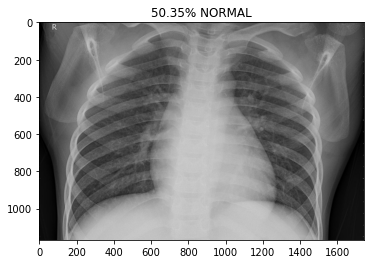

prob:[0.00306225 0.99693775]
NORMAL/NORMAL2-IM-0252-0001.jpeg


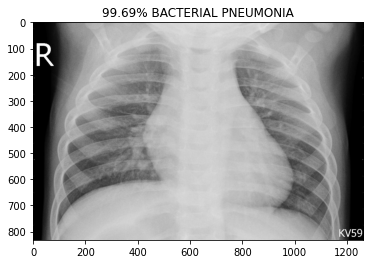

prob:[6.3373067e-04 9.9936634e-01]
NORMAL/NORMAL2-IM-0256-0001.jpeg


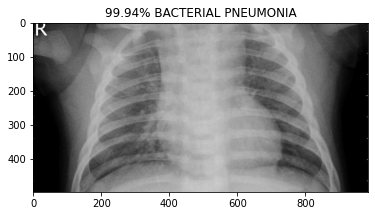

prob:[0.1901582 0.8098418]
NORMAL/NORMAL2-IM-0259-0001.jpeg


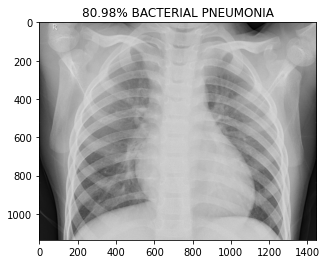

prob:[0.48894393 0.51105607]
NORMAL/NORMAL2-IM-0267-0001.jpeg


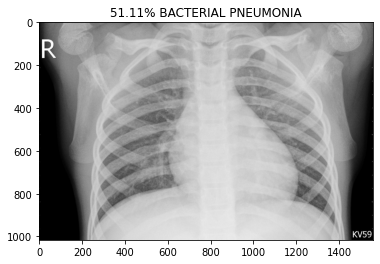

prob:[0.7142891  0.28571087]
NORMAL/NORMAL2-IM-0271-0001.jpeg


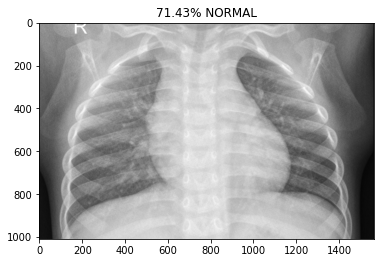

prob:[0.606226 0.393774]
NORMAL/NORMAL2-IM-0272-0001.jpeg


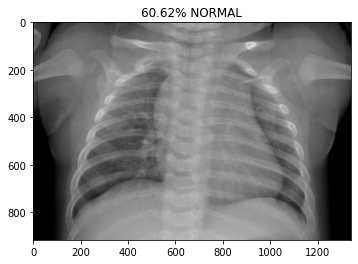

prob:[0.88357145 0.11642852]
NORMAL/NORMAL2-IM-0273-0001.jpeg


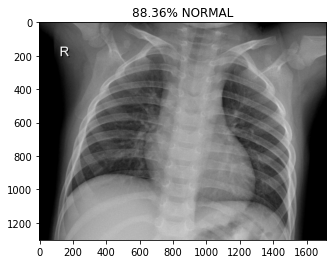

prob:[0.9864369  0.01356313]
NORMAL/NORMAL2-IM-0274-0001.jpeg


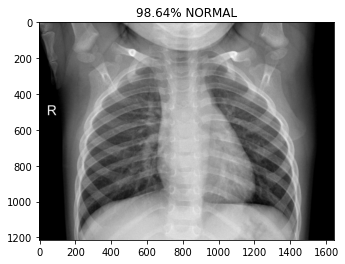

prob:[0.99071    0.00929005]
NORMAL/NORMAL2-IM-0275-0001.jpeg


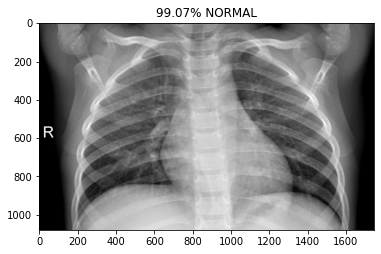

prob:[0.6432099 0.3567901]
NORMAL/NORMAL2-IM-0276-0001.jpeg


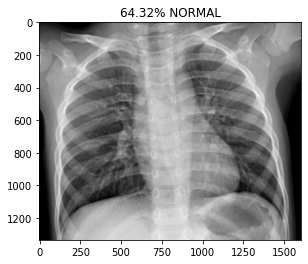

prob:[0.37312117 0.62687886]
NORMAL/NORMAL2-IM-0277-0001.jpeg


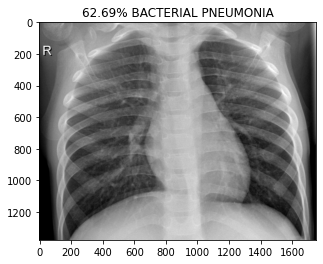

prob:[0.9737837  0.02621632]
NORMAL/NORMAL2-IM-0278-0001.jpeg


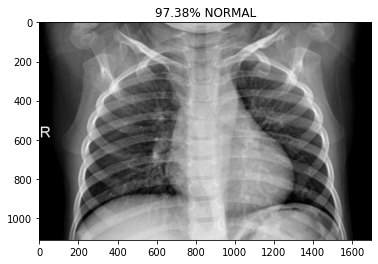

prob:[0.9875507  0.01244933]
NORMAL/NORMAL2-IM-0279-0001.jpeg


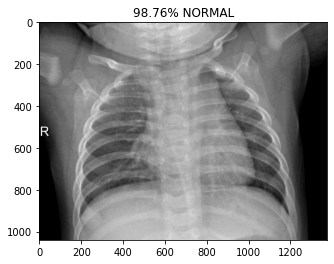

prob:[0.8746481  0.12535194]
NORMAL/NORMAL2-IM-0280-0001.jpeg


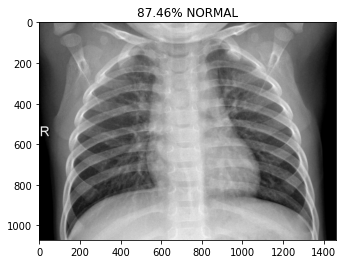

prob:[0.890591   0.10940897]
NORMAL/NORMAL2-IM-0281-0001.jpeg


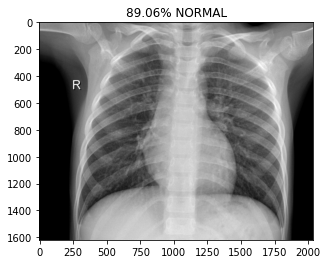

prob:[0.94521457 0.05478542]
NORMAL/NORMAL2-IM-0282-0001.jpeg


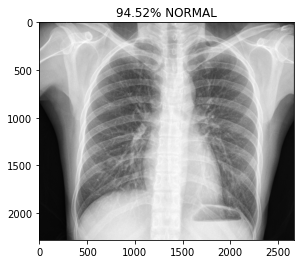

prob:[0.3203185  0.67968154]
NORMAL/NORMAL2-IM-0283-0001.jpeg


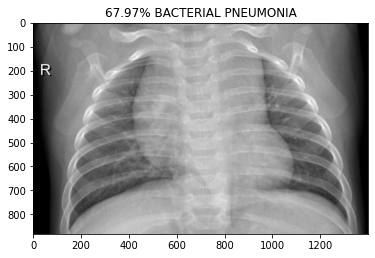

prob:[0.01948296 0.9805171 ]
NORMAL/NORMAL2-IM-0285-0001.jpeg


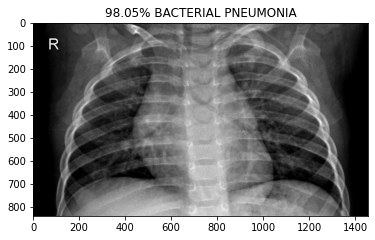

prob:[0.9831376  0.01686234]
NORMAL/NORMAL2-IM-0286-0001.jpeg


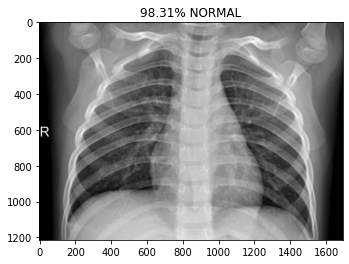

prob:[0.9965655 0.0034345]
NORMAL/NORMAL2-IM-0287-0001.jpeg


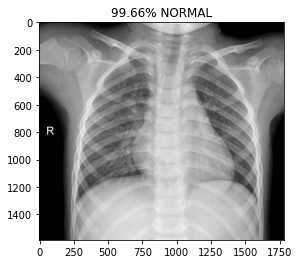

prob:[0.68932676 0.3106733 ]
NORMAL/NORMAL2-IM-0288-0001.jpeg


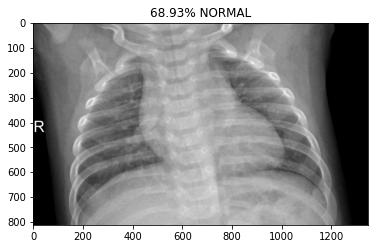

prob:[0.996438   0.00356196]
NORMAL/NORMAL2-IM-0289-0001.jpeg


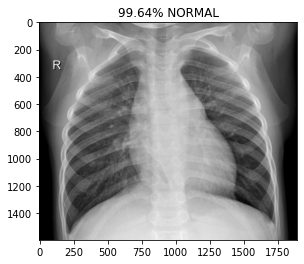

prob:[0.9496012  0.05039883]
NORMAL/NORMAL2-IM-0290-0001.jpeg


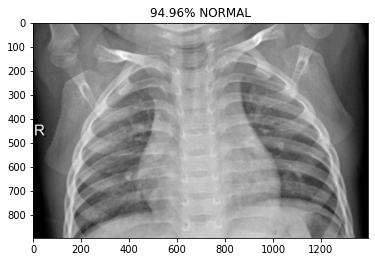

prob:[0.9570943  0.04290571]
NORMAL/NORMAL2-IM-0292-0001.jpeg


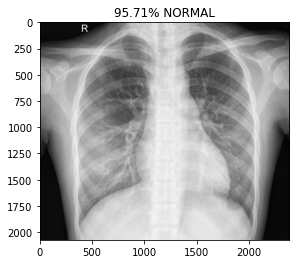

prob:[0.6974403  0.30255967]
NORMAL/NORMAL2-IM-0294-0001.jpeg


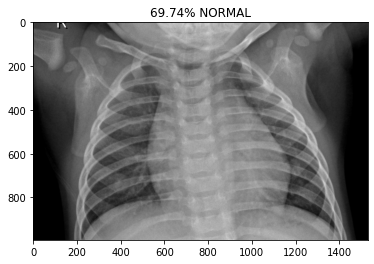

prob:[0.9042009  0.09579913]
NORMAL/NORMAL2-IM-0297-0001.jpeg


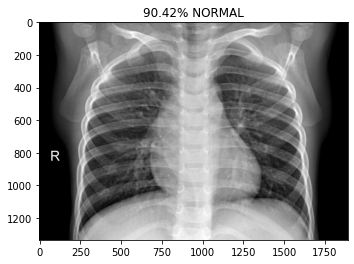

prob:[0.9936698  0.00633024]
NORMAL/NORMAL2-IM-0300-0001.jpeg


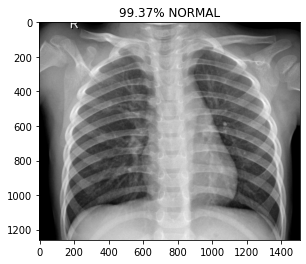

prob:[0.9654487  0.03455128]
NORMAL/NORMAL2-IM-0301-0001.jpeg


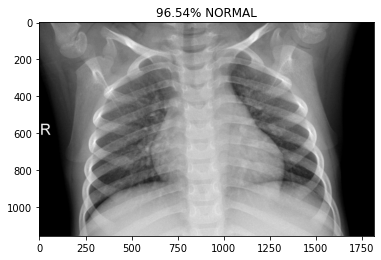

prob:[0.18489243 0.8151076 ]
NORMAL/NORMAL2-IM-0302-0001.jpeg


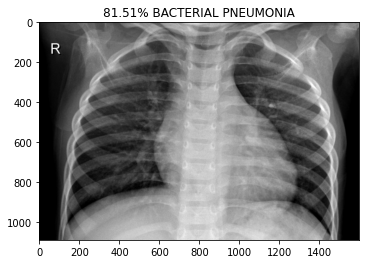

prob:[0.6045445  0.39545542]
NORMAL/NORMAL2-IM-0303-0001.jpeg


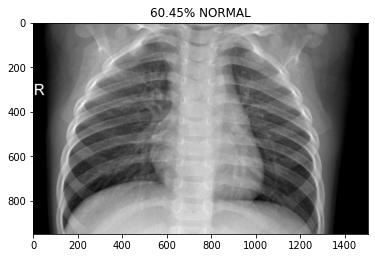

prob:[0.9285531  0.07144693]
NORMAL/NORMAL2-IM-0304-0001.jpeg


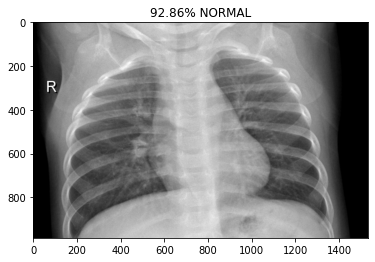

prob:[0.8468742  0.15312578]
NORMAL/NORMAL2-IM-0305-0001.jpeg


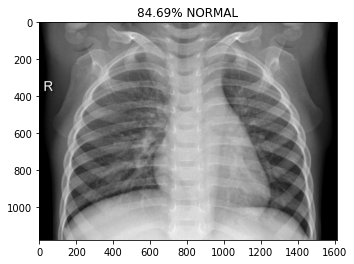

prob:[0.99456173 0.00543822]
NORMAL/NORMAL2-IM-0307-0001.jpeg


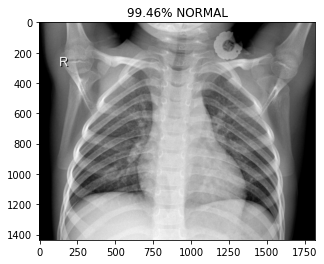

prob:[0.9936366  0.00636336]
NORMAL/NORMAL2-IM-0309-0001.jpeg


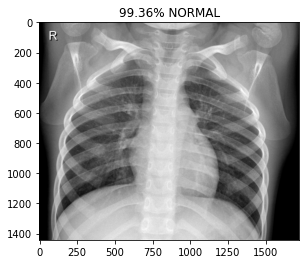

prob:[9.994116e-01 5.884088e-04]
NORMAL/NORMAL2-IM-0310-0001.jpeg


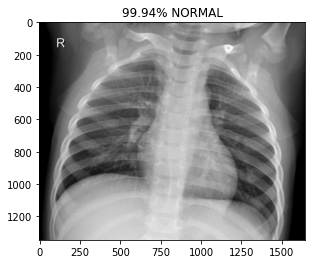

prob:[0.9835474  0.01645264]
NORMAL/NORMAL2-IM-0311-0001.jpeg


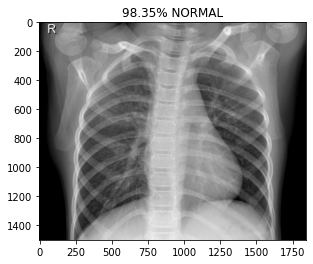

prob:[0.98491055 0.0150895 ]
NORMAL/NORMAL2-IM-0312-0001.jpeg


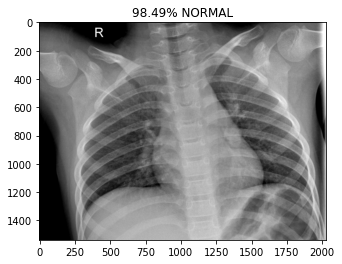

prob:[0.5497939  0.45020613]
NORMAL/NORMAL2-IM-0313-0001.jpeg


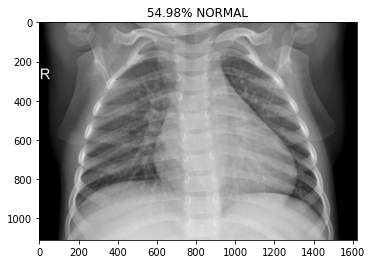

prob:[0.03823132 0.9617687 ]
NORMAL/NORMAL2-IM-0315-0001.jpeg


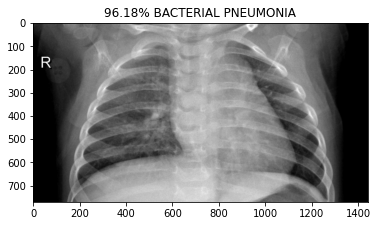

prob:[0.0234815  0.97651845]
NORMAL/NORMAL2-IM-0316-0001.jpeg


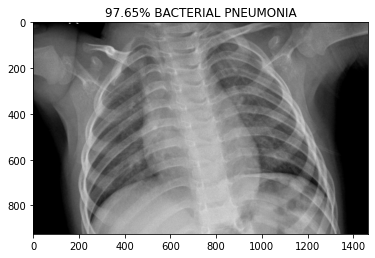

prob:[0.90994674 0.0900532 ]
NORMAL/NORMAL2-IM-0317-0001.jpeg


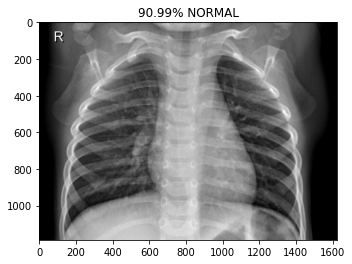

prob:[0.9610351  0.03896489]
NORMAL/NORMAL2-IM-0319-0001.jpeg


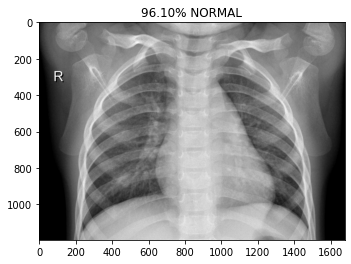

prob:[0.99758184 0.00241813]
NORMAL/NORMAL2-IM-0321-0001.jpeg


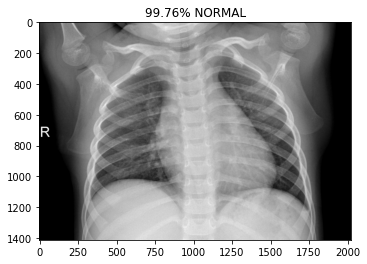

prob:[0.3592891  0.64071083]
NORMAL/NORMAL2-IM-0322-0001.jpeg


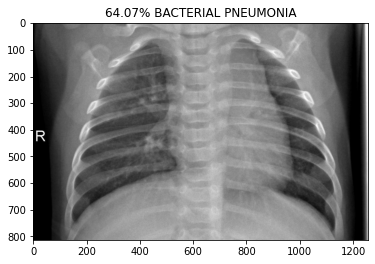

prob:[0.99480903 0.00519095]
NORMAL/NORMAL2-IM-0323-0001.jpeg


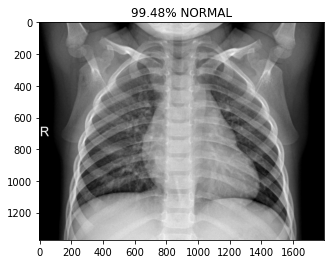

prob:[0.8008721  0.19912794]
NORMAL/NORMAL2-IM-0325-0001.jpeg


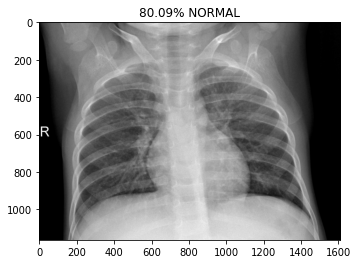

prob:[0.8261467  0.17385332]
NORMAL/NORMAL2-IM-0326-0001.jpeg


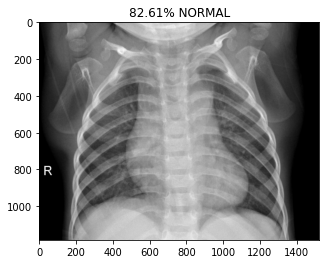

prob:[0.39181012 0.60818994]
NORMAL/NORMAL2-IM-0327-0001.jpeg


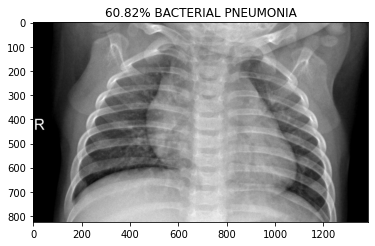

prob:[0.79399574 0.20600422]
NORMAL/NORMAL2-IM-0328-0001.jpeg


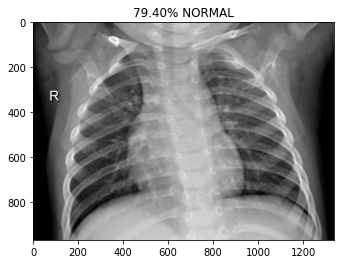

prob:[0.9858289  0.01417118]
NORMAL/NORMAL2-IM-0329-0001.jpeg


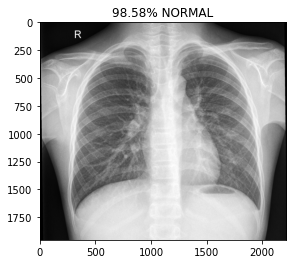

prob:[0.0130429 0.9869571]
NORMAL/NORMAL2-IM-0330-0001.jpeg


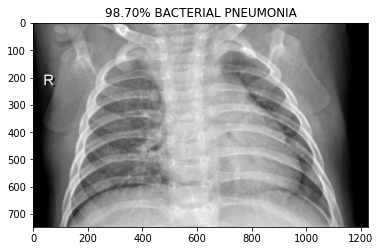

prob:[0.89386755 0.10613248]
NORMAL/NORMAL2-IM-0331-0001.jpeg


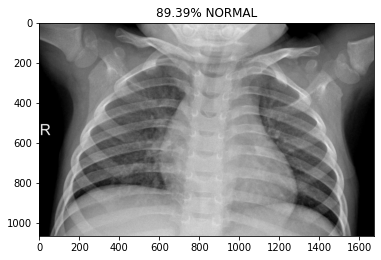

prob:[0.75479525 0.24520478]
NORMAL/NORMAL2-IM-0332-0001.jpeg


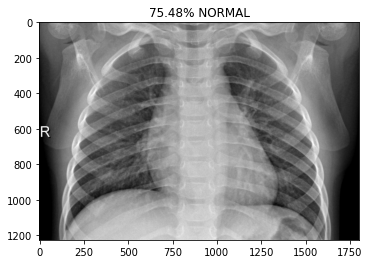

prob:[0.99434054 0.00565941]
NORMAL/NORMAL2-IM-0333-0001.jpeg


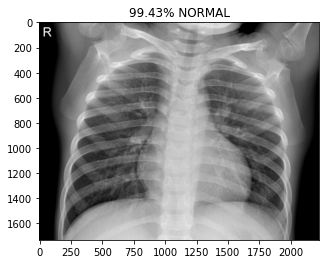

prob:[0.74289435 0.25710562]
NORMAL/NORMAL2-IM-0335-0001.jpeg


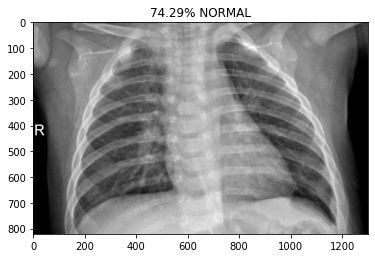

prob:[0.64132726 0.3586727 ]
NORMAL/NORMAL2-IM-0336-0001.jpeg


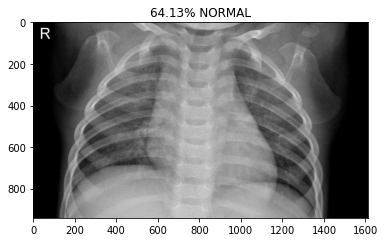

prob:[0.9952394  0.00476066]
NORMAL/NORMAL2-IM-0337-0001.jpeg


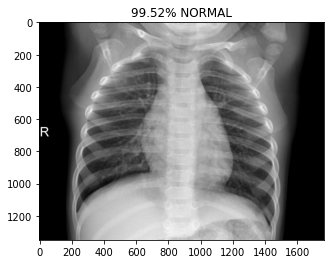

prob:[0.00239213 0.9976078 ]
NORMAL/NORMAL2-IM-0338-0001.jpeg


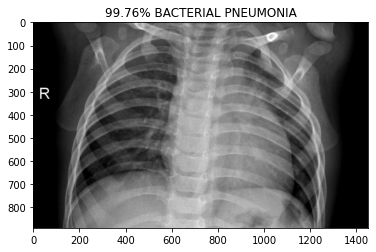

prob:[0.9981534  0.00184658]
NORMAL/NORMAL2-IM-0339-0001.jpeg


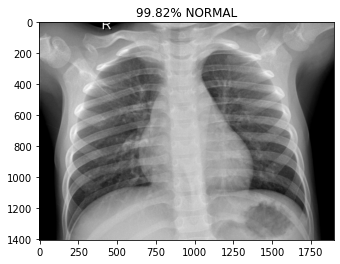

prob:[0.36794928 0.63205075]
NORMAL/NORMAL2-IM-0340-0001.jpeg


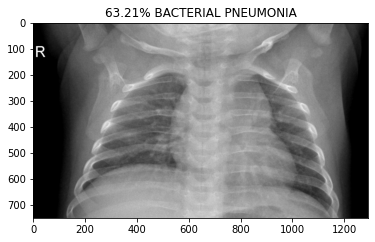

prob:[9.993641e-01 6.358978e-04]
NORMAL/NORMAL2-IM-0341-0001.jpeg


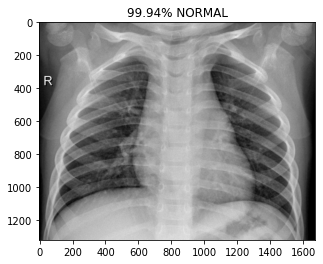

prob:[0.52296895 0.47703105]
NORMAL/NORMAL2-IM-0343-0001.jpeg


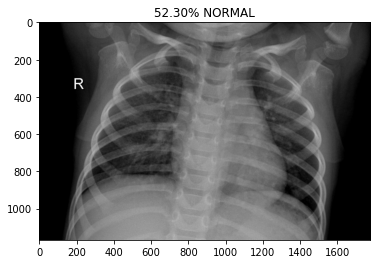

prob:[0.3652022 0.6347978]
NORMAL/NORMAL2-IM-0345-0001.jpeg


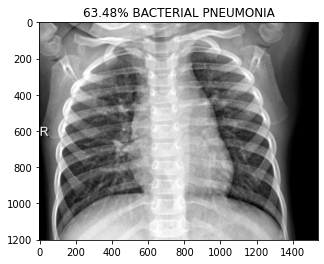

prob:[0.9324512  0.06754883]
NORMAL/NORMAL2-IM-0346-0001.jpeg


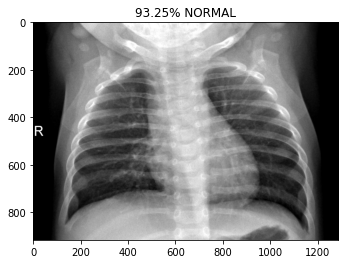

prob:[0.8286045  0.17139547]
NORMAL/NORMAL2-IM-0347-0001.jpeg


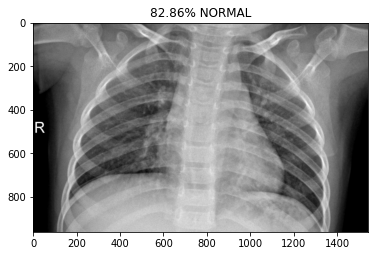

prob:[0.9335104  0.06648956]
NORMAL/NORMAL2-IM-0348-0001.jpeg


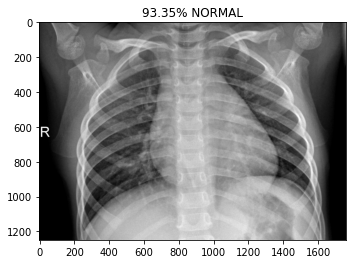

prob:[0.04476053 0.9552394 ]
NORMAL/NORMAL2-IM-0349-0001.jpeg


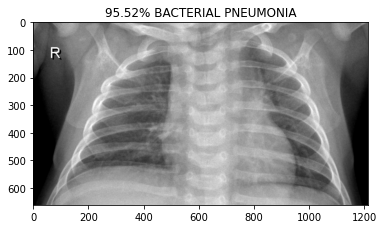

prob:[0.82775295 0.17224705]
NORMAL/NORMAL2-IM-0350-0001.jpeg


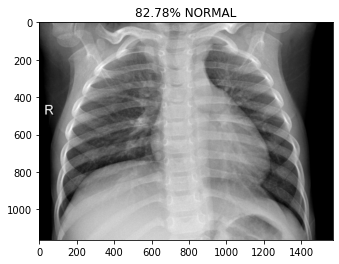

prob:[0.96732146 0.03267847]
NORMAL/NORMAL2-IM-0351-0001.jpeg


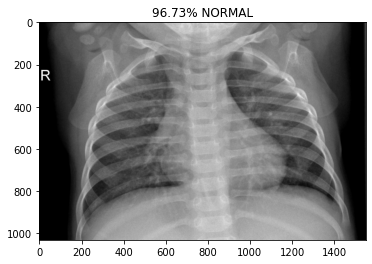

prob:[0.889824   0.11017601]
NORMAL/NORMAL2-IM-0352-0001.jpeg


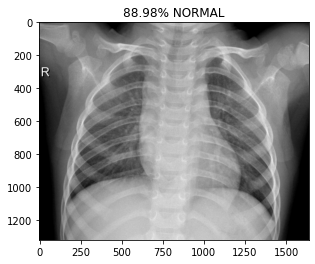

prob:[0.7953671  0.20463285]
NORMAL/NORMAL2-IM-0353-0001.jpeg


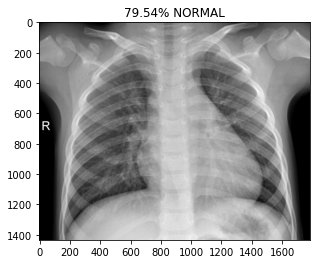

prob:[0.83044845 0.1695516 ]
NORMAL/NORMAL2-IM-0354-0001.jpeg


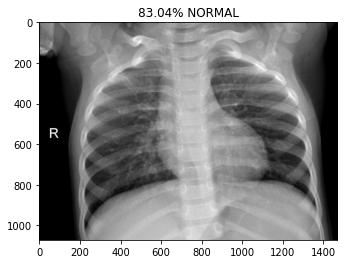

prob:[0.98940253 0.01059749]
NORMAL/NORMAL2-IM-0357-0001.jpeg


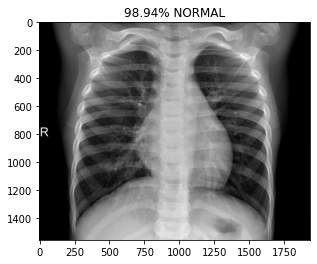

prob:[0.6891084  0.31089163]
NORMAL/NORMAL2-IM-0359-0001.jpeg


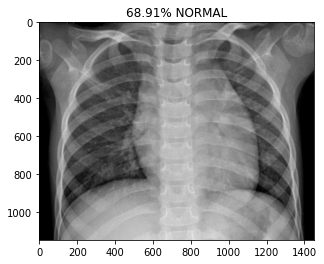

prob:[0.43656477 0.5634352 ]
NORMAL/NORMAL2-IM-0360-0001.jpeg


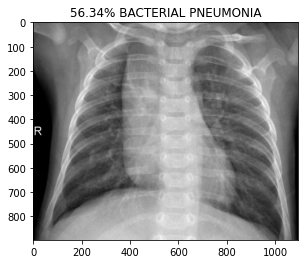

prob:[0.35451904 0.645481  ]
NORMAL/NORMAL2-IM-0361-0001.jpeg


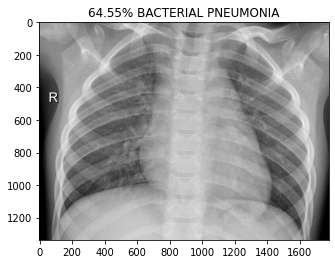

prob:[0.7019225  0.29807752]
NORMAL/NORMAL2-IM-0362-0001.jpeg


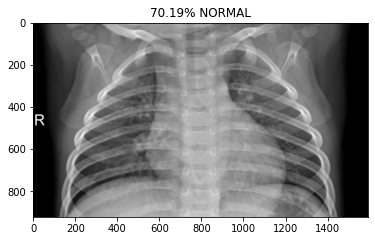

prob:[0.6656343 0.3343657]
NORMAL/NORMAL2-IM-0364-0001.jpeg


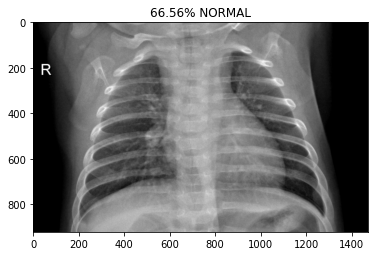

prob:[0.63940877 0.3605912 ]
NORMAL/NORMAL2-IM-0366-0001.jpeg


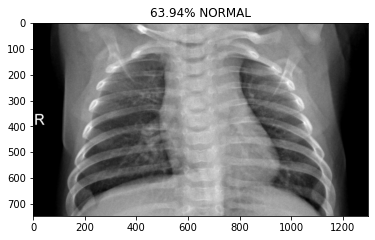

prob:[0.19604333 0.8039567 ]
NORMAL/NORMAL2-IM-0368-0001.jpeg


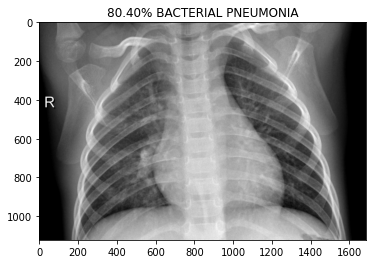

prob:[0.8185323  0.18146768]
NORMAL/NORMAL2-IM-0369-0001.jpeg


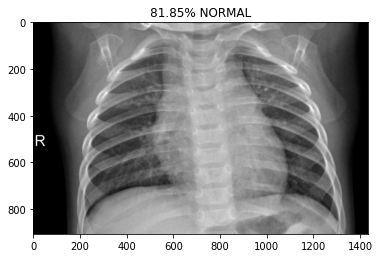

prob:[0.99363846 0.00636157]
NORMAL/NORMAL2-IM-0370-0001.jpeg


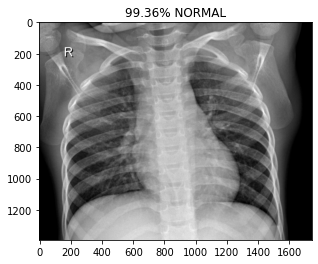

prob:[0.9974928 0.0025072]
NORMAL/NORMAL2-IM-0372-0001.jpeg


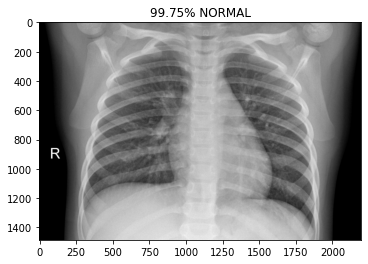

prob:[0.00747309 0.9925269 ]
NORMAL/NORMAL2-IM-0373-0001.jpeg


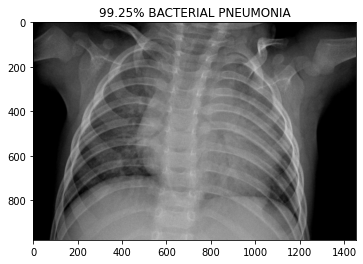

prob:[0.9634061  0.03659386]
NORMAL/NORMAL2-IM-0374-0001-0001.jpeg


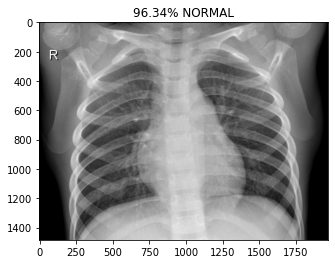

prob:[0.22395912 0.7760409 ]
NORMAL/NORMAL2-IM-0374-0001-0002.jpeg


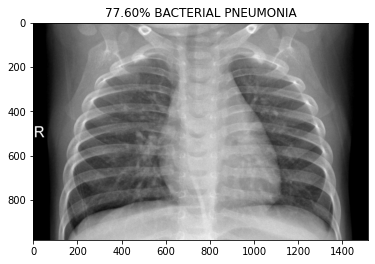

prob:[0.99182606 0.00817388]
NORMAL/NORMAL2-IM-0374-0001.jpeg


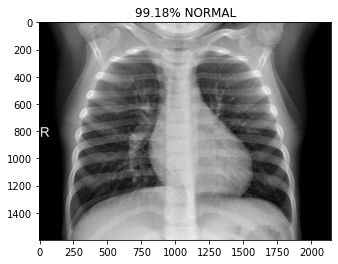

prob:[0.00393137 0.9960686 ]
NORMAL/NORMAL2-IM-0376-0001.jpeg


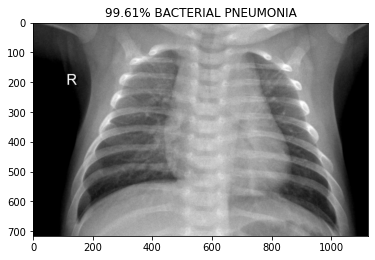

prob:[0.9474643  0.05253575]
NORMAL/NORMAL2-IM-0378-0001.jpeg


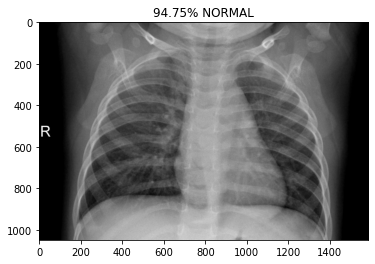

prob:[0.9921699  0.00783006]
NORMAL/NORMAL2-IM-0380-0001.jpeg


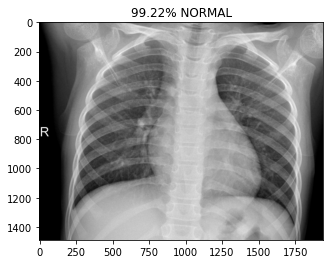

prob:[0.97194064 0.02805934]
NORMAL/NORMAL2-IM-0381-0001.jpeg


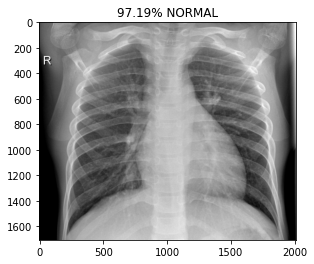

prob:[0.0289995 0.9710005]
PNEUMONIA/person100_bacteria_475.jpeg


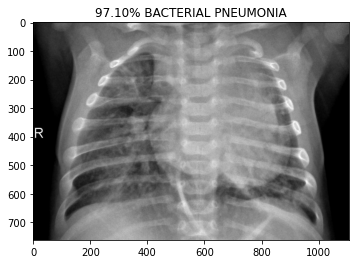

prob:[0.00115266 0.99884737]
PNEUMONIA/person100_bacteria_477.jpeg


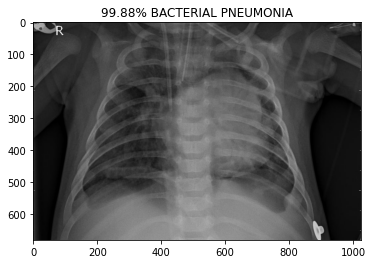

prob:[7.325826e-05 9.999267e-01]
PNEUMONIA/person100_bacteria_478.jpeg


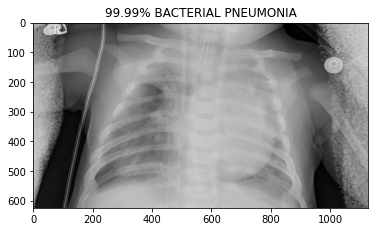

prob:[8.1805367e-04 9.9918193e-01]
PNEUMONIA/person100_bacteria_479.jpeg


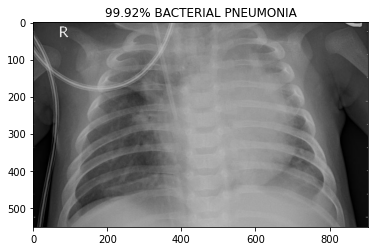

prob:[6.393679e-05 9.999361e-01]
PNEUMONIA/person100_bacteria_480.jpeg


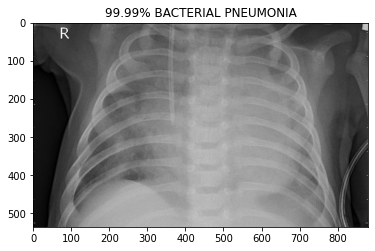

prob:[2.4974088e-05 9.9997497e-01]
PNEUMONIA/person100_bacteria_481.jpeg


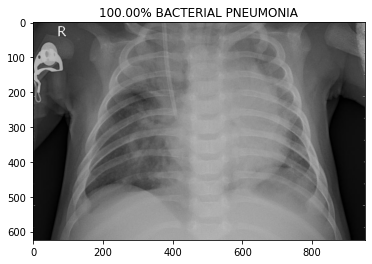

prob:[3.6224501e-05 9.9996376e-01]
PNEUMONIA/person100_bacteria_482.jpeg


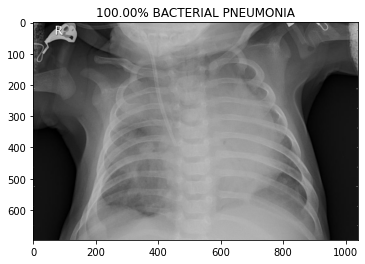

prob:[3.1084655e-05 9.9996889e-01]
PNEUMONIA/person101_bacteria_483.jpeg


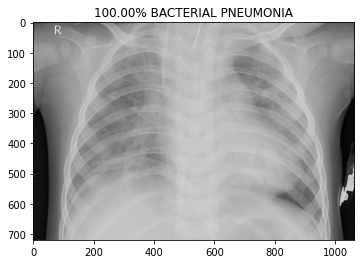

prob:[4.8411643e-04 9.9951589e-01]
PNEUMONIA/person101_bacteria_484.jpeg


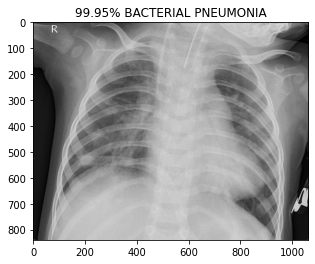

prob:[4.6378944e-05 9.9995363e-01]
PNEUMONIA/person101_bacteria_485.jpeg


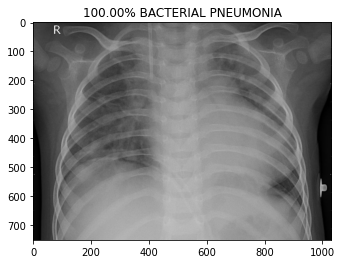

prob:[2.1861339e-05 9.9997818e-01]
PNEUMONIA/person101_bacteria_486.jpeg


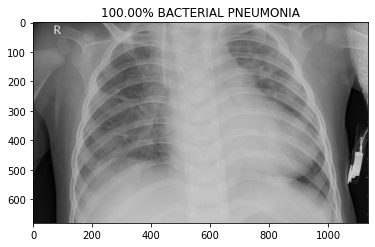

prob:[0.00248189 0.9975182 ]
PNEUMONIA/person102_bacteria_487.jpeg


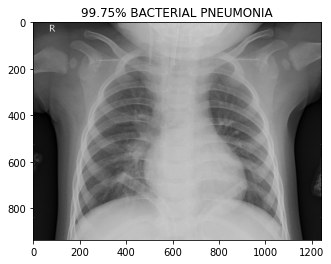

prob:[2.3035534e-05 9.9997699e-01]
PNEUMONIA/person103_bacteria_488.jpeg


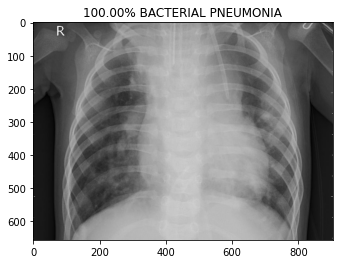

prob:[1.6887982e-04 9.9983108e-01]
PNEUMONIA/person103_bacteria_489.jpeg


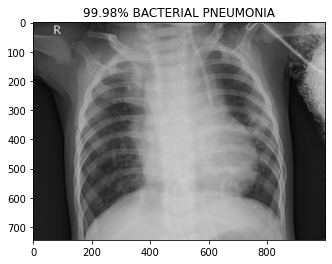

prob:[0.00228265 0.9977174 ]
PNEUMONIA/person103_bacteria_490.jpeg


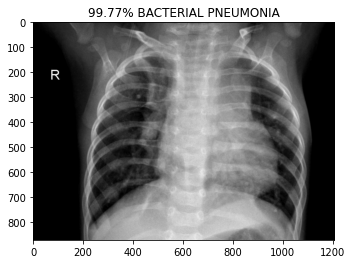

prob:[2.8888616e-04 9.9971110e-01]
PNEUMONIA/person104_bacteria_491.jpeg


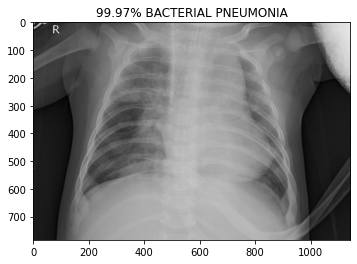

prob:[2.7072194e-04 9.9972922e-01]
PNEUMONIA/person104_bacteria_492.jpeg


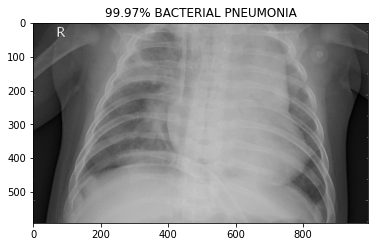

prob:[6.6258875e-04 9.9933738e-01]
PNEUMONIA/person108_bacteria_504.jpeg


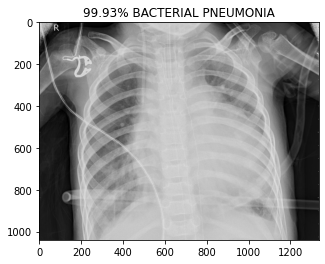

prob:[0.00536432 0.99463564]
PNEUMONIA/person108_bacteria_506.jpeg


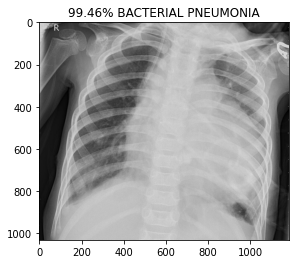

prob:[4.684790e-04 9.995315e-01]
PNEUMONIA/person108_bacteria_507.jpeg


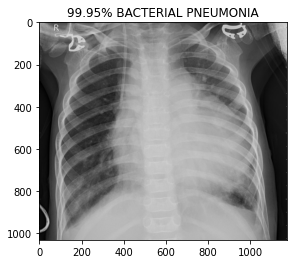

prob:[0.1446679 0.8553321]
PNEUMONIA/person108_bacteria_511.jpeg


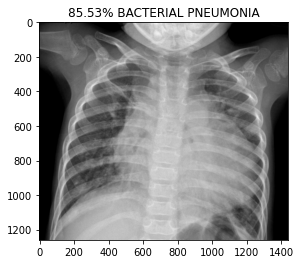

prob:[4.0332994e-05 9.9995971e-01]
PNEUMONIA/person109_bacteria_512.jpeg


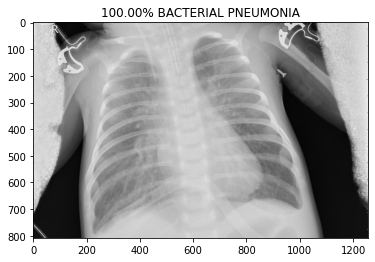

prob:[6.5576103e-05 9.9993443e-01]
PNEUMONIA/person109_bacteria_513.jpeg


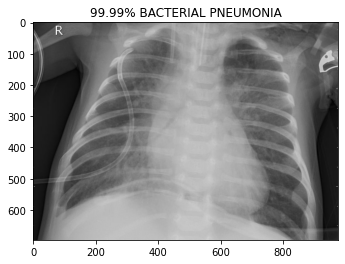

prob:[0.00140895 0.998591  ]
PNEUMONIA/person109_bacteria_517.jpeg


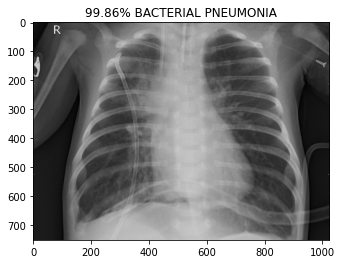

prob:[2.5310207e-04 9.9974686e-01]
PNEUMONIA/person109_bacteria_519.jpeg


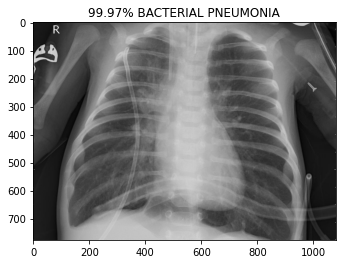

prob:[1.543020e-04 9.998456e-01]
PNEUMONIA/person109_bacteria_522.jpeg


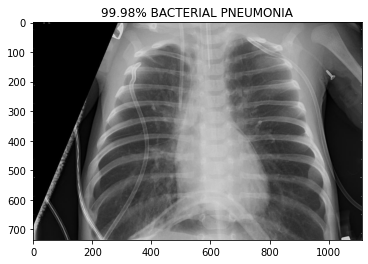

prob:[1.6772743e-04 9.9983227e-01]
PNEUMONIA/person109_bacteria_523.jpeg


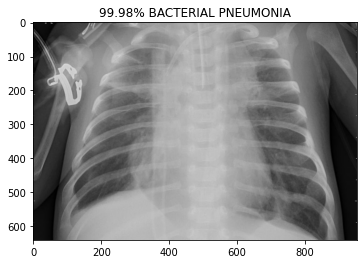

prob:[2.4103669e-05 9.9997592e-01]
PNEUMONIA/person109_bacteria_526.jpeg


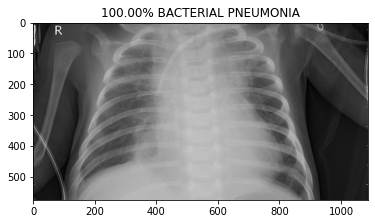

prob:[2.3963719e-05 9.9997604e-01]
PNEUMONIA/person109_bacteria_527.jpeg


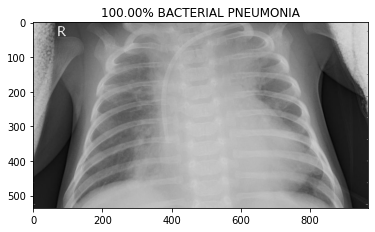

prob:[2.0380809e-04 9.9979621e-01]
PNEUMONIA/person109_bacteria_528.jpeg


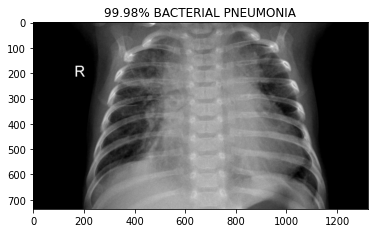

prob:[2.3767812e-04 9.9976236e-01]
PNEUMONIA/person110_bacteria_531.jpeg


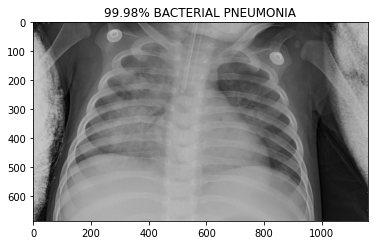

prob:[1.5407237e-05 9.9998462e-01]
PNEUMONIA/person111_bacteria_533.jpeg


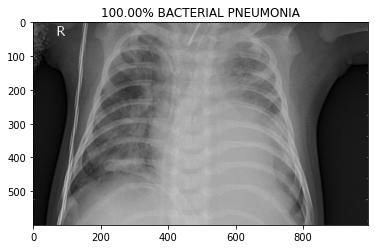

prob:[1.3611327e-04 9.9986386e-01]
PNEUMONIA/person111_bacteria_534.jpeg


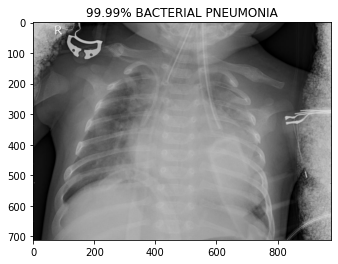

prob:[6.323933e-05 9.999367e-01]
PNEUMONIA/person111_bacteria_535.jpeg


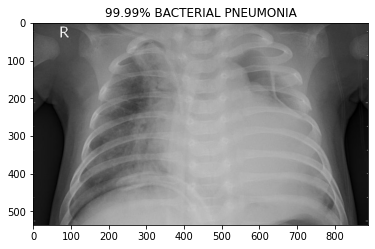

prob:[5.7089818e-04 9.9942905e-01]
PNEUMONIA/person111_bacteria_536.jpeg


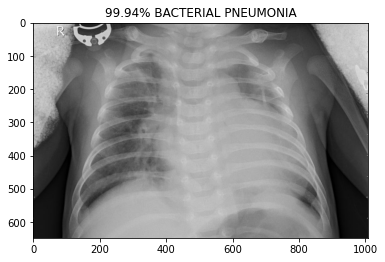

prob:[7.4701896e-04 9.9925297e-01]
PNEUMONIA/person111_bacteria_537.jpeg


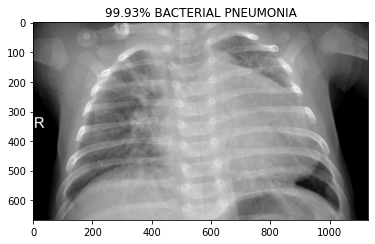

prob:[2.337475e-04 9.997663e-01]
PNEUMONIA/person112_bacteria_538.jpeg


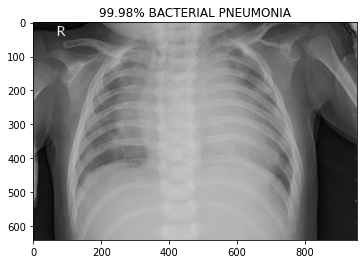

prob:[0.00130459 0.99869543]
PNEUMONIA/person112_bacteria_539.jpeg


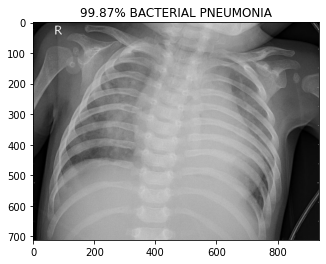

prob:[6.6729248e-05 9.9993324e-01]
PNEUMONIA/person113_bacteria_540.jpeg


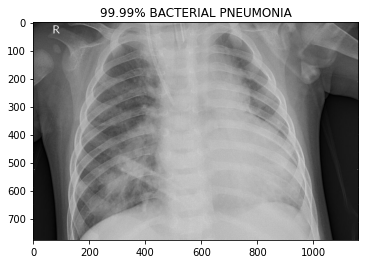

prob:[9.8487450e-05 9.9990153e-01]
PNEUMONIA/person113_bacteria_541.jpeg


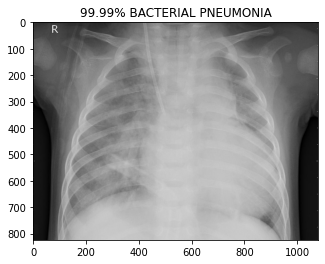

prob:[1.2138056e-04 9.9987864e-01]
PNEUMONIA/person113_bacteria_542.jpeg


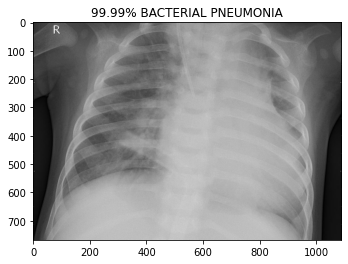

prob:[0.01591041 0.9840896 ]
PNEUMONIA/person113_bacteria_543.jpeg


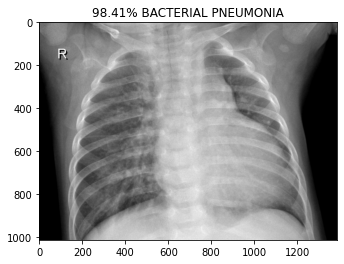

prob:[0.00118792 0.9988121 ]
PNEUMONIA/person114_bacteria_544.jpeg


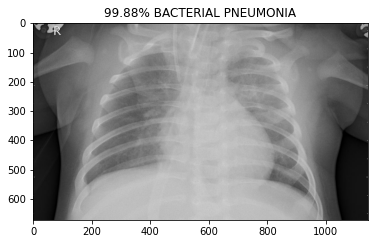

prob:[0.00244777 0.9975522 ]
PNEUMONIA/person114_bacteria_545.jpeg


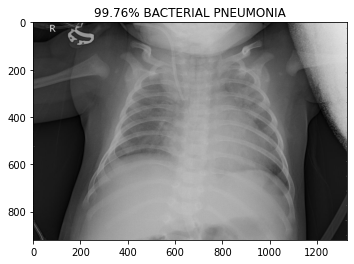

prob:[2.0953297e-04 9.9979049e-01]
PNEUMONIA/person114_bacteria_546.jpeg


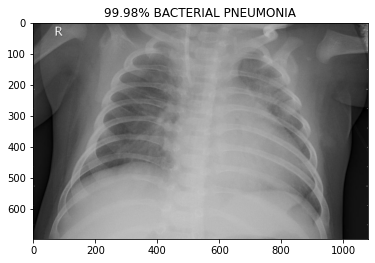

prob:[0.01080172 0.98919827]
PNEUMONIA/person117_bacteria_553.jpeg


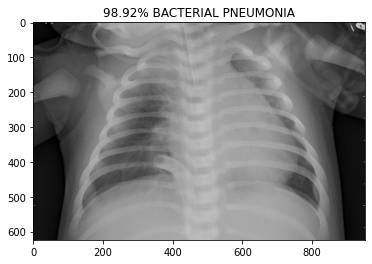

prob:[0.01601513 0.9839849 ]
PNEUMONIA/person117_bacteria_556.jpeg


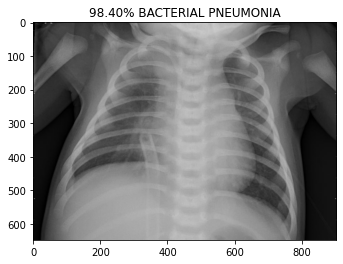

prob:[0.041702   0.95829797]
PNEUMONIA/person117_bacteria_557.jpeg


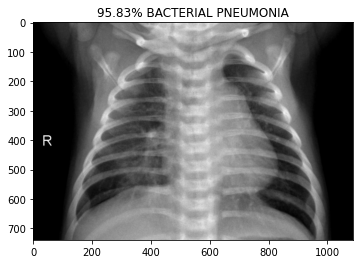

prob:[0.00537993 0.9946201 ]
PNEUMONIA/person118_bacteria_559.jpeg


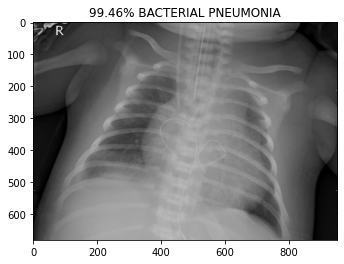

prob:[0.05923362 0.9407664 ]
PNEUMONIA/person118_bacteria_560.jpeg


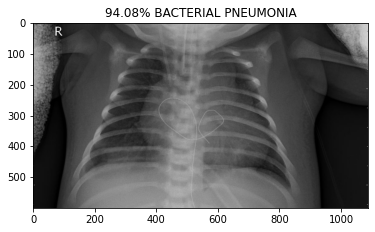

prob:[1.16846124e-04 9.99883175e-01]
PNEUMONIA/person119_bacteria_565.jpeg


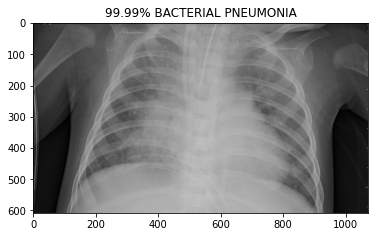

prob:[4.3484473e-05 9.9995649e-01]
PNEUMONIA/person119_bacteria_566.jpeg


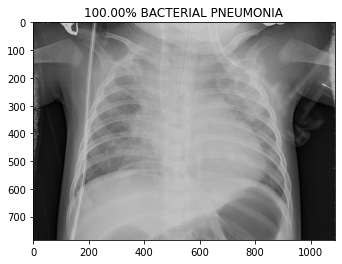

prob:[0.01161412 0.9883859 ]
PNEUMONIA/person119_bacteria_567.jpeg


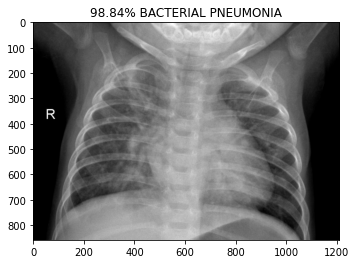

prob:[0.02195372 0.9780463 ]
PNEUMONIA/person119_bacteria_568.jpeg


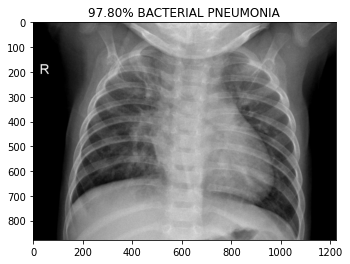

prob:[5.720077e-04 9.994280e-01]
PNEUMONIA/person120_bacteria_570.jpeg


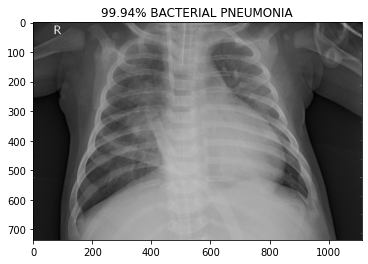

prob:[9.738020e-06 9.999902e-01]
PNEUMONIA/person120_bacteria_571.jpeg


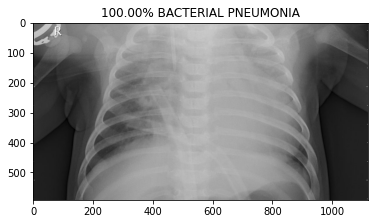

prob:[2.1765414e-05 9.9997818e-01]
PNEUMONIA/person120_bacteria_572.jpeg


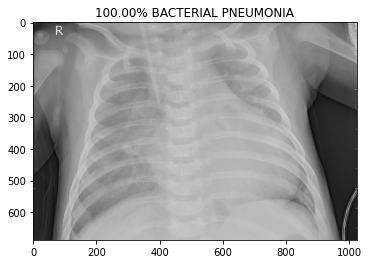

prob:[3.6269013e-04 9.9963725e-01]
PNEUMONIA/person120_bacteria_573.jpeg


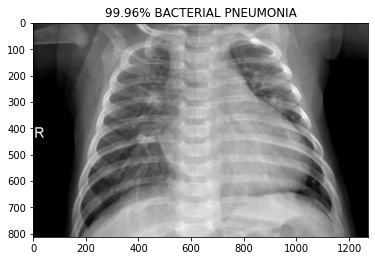

prob:[2.5889231e-04 9.9974114e-01]
PNEUMONIA/person121_bacteria_575.jpeg


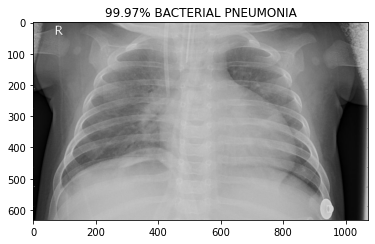

prob:[9.189841e-05 9.999081e-01]
PNEUMONIA/person121_bacteria_576.jpeg


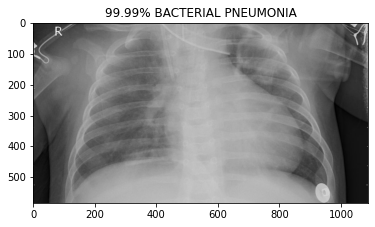

prob:[3.5002225e-04 9.9965000e-01]
PNEUMONIA/person121_bacteria_578.jpeg


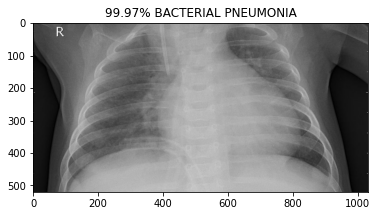

prob:[1.3320327e-04 9.9986672e-01]
PNEUMONIA/person121_bacteria_579.jpeg


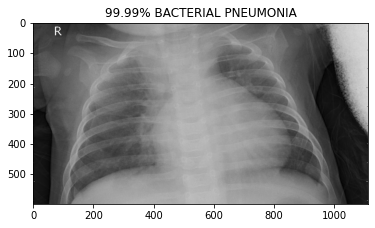

prob:[0.01158032 0.98841965]
PNEUMONIA/person121_bacteria_580.jpeg


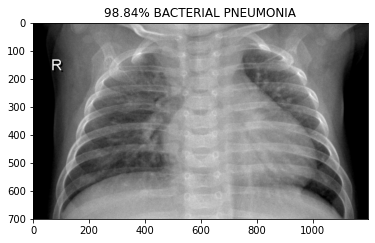

prob:[0.0585437  0.94145626]
PNEUMONIA/person122_bacteria_581.jpeg


KeyboardInterrupt: ignored

In [ ]:
pred = model.predict_generator(test_set,10,verbose=1)
print("Predictions finished")
import cv2
import matplotlib.image as mpimg
for index, probability in enumerate(pred):
 image_path = test + "/" +test_set.filenames[index]
 image = mpimg.imread(image_path)
 image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
 pixels = np.array(image)
 plt.imshow(pixels)
 print("prob:{}".format(probability))
 print(test_set.filenames[index])
 if probability[1] > 0.5:
     plt.title('%.2f' % (probability[1]*100) + '% BACTERIAL PNEUMONIA')
 else:
     plt.title('%.2f' % ((1-probability[1])*100) + '% NORMAL')
 plt.show()

In [ ]:
#from tensorflow.keras.models import load_model
#filepath = 'saved_model/bacterial_normal.h5'
#new_model = load_model(filepath)

In [ ]:
prediction=model.predict(test_set, use_multiprocessing=True)
print(prediction)

[[9.33901608e-01 6.60983250e-02]
 [9.91643369e-01 8.35655257e-03]
 [9.92019832e-01 7.98016973e-03]
 [9.64179456e-01 3.58205289e-02]
 [9.81941104e-01 1.80589408e-02]
 [9.98146534e-01 1.85344566e-03]
 [9.90733147e-01 9.26687010e-03]
 [8.43438387e-01 1.56561583e-01]
 [7.83190250e-01 2.16809794e-01]
 [9.83709693e-01 1.62903257e-02]
 [9.98637021e-01 1.36293843e-03]
 [9.21257496e-01 7.87425339e-02]
 [9.98749137e-01 1.25086226e-03]
 [9.94612932e-01 5.38710924e-03]
 [8.33404362e-01 1.66595638e-01]
 [9.04570341e-01 9.54296365e-02]
 [2.42487018e-04 9.99757469e-01]
 [9.86679256e-01 1.33206844e-02]
 [9.97647226e-01 2.35280767e-03]
 [9.82459784e-01 1.75402816e-02]
 [9.07500029e-01 9.24999565e-02]
 [9.96941149e-01 3.05886962e-03]
 [8.93055975e-01 1.06944039e-01]
 [8.85669470e-01 1.14330493e-01]
 [9.80262935e-01 1.97370313e-02]
 [9.98730958e-01 1.26908894e-03]
 [9.88920510e-01 1.10795042e-02]
 [9.97356534e-01 2.64347740e-03]
 [9.82165396e-01 1.78346168e-02]
 [8.48931313e-01 1.51068717e-01]
 [4.949491

In [ ]:
import keras
import cv2
import numpy as np
import argparse
import os
import pandas as pd
from keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
tf.config.list_physical_devices('GPU') 
from tensorflow.keras.applications import VGG16,InceptionV3
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing import image
from tensorflow.keras.layers import AveragePooling2D, Dropout,Flatten, Dense, Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
tf.test.is_gpu_available(
    cuda_only=False, min_cuda_compute_capability=None
)
from sklearn.metrics import classification_report, confusion_matrix,plot_confusion_matrix
import seaborn as sn
import itertools
from sklearn.metrics import precision_recall_fscore_support
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import BatchNormalization, Conv2D, MaxPooling2D, UpSampling2D, Add, Activation, Multiply, concatenate

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


Confusion matrix, without normalization


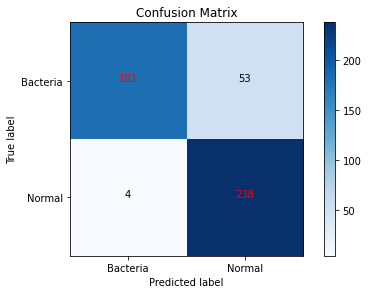

Normalized confusion matrix


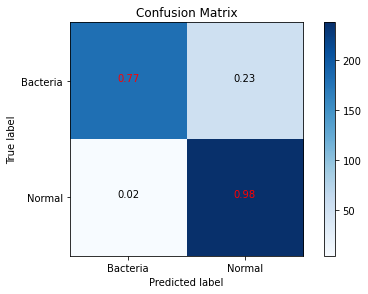

In [ ]:
def plot_confusion_matrix(cm, classes,
    normalize=False,
    title='Confusion matrix',
    cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
    
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="red" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()
y_pred = np.argmax(prediction, axis=1)
cm=confusion_matrix(test_set.classes, y_pred)
cm_labels= ['Bacteria','Normal']
plot_confusion_matrix(cm=cm, classes=cm_labels, title='Confusion Matrix')
plot_confusion_matrix(cm=cm, classes=cm_labels, title='Confusion Matrix', normalize=True)


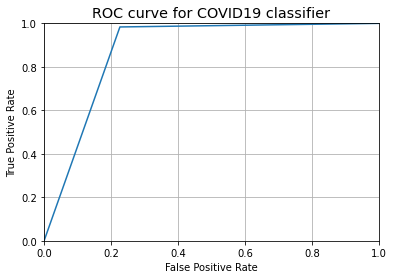

In [ ]:
from sklearn import metrics
fpr, tpr, thresholds = metrics.roc_curve(test_set.classes, y_pred)

plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.rcParams['font.size'] = 12
plt.title('ROC curve for COVID19 classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.grid(True)

In [ ]:
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.applications import imagenet_utils

import imutils

VISUALIAZTION

In [ ]:

orig = cv2.imread("/content/drive/MyDrive/Bact_data/val/NORMAL/NORMAL2-IM-1427-0001.jpeg")
resized = cv2.resize(orig, (224, 224))

image = load_img("/content/drive/MyDrive/Bact_data/val/NORMAL/NORMAL2-IM-1427-0001.jpeg", target_size=(224, 224))
image = img_to_array(image)
image = image.astype('float32') / 255
image = np.expand_dims(image, axis=0)

In [ ]:
preds = model.predict(image)
i = np.argmax(preds[0])
print(i)

0


In [ ]:
class GradCAM:                                                                            #GRADCAM SRC = https://keras.io/examples/vision/grad_cam/
    def __init__(self, model, classIdx, layerName=None):

        self.model = model
        self.classIdx = classIdx
        self.layerName = layerName

        if self.layerName is None:
            self.layerName = self.find_target_layer()

    def find_target_layer(self):

        for layer in reversed(self.model.layers):
            if len(layer.output.shape) == 4:
                return layer.name

        raise ValueError("Could not find 4D layer. Cannot apply GradCAM.")

    def compute_heatmap(self, image, eps=1e-8):
        gradModel = Model(inputs=[self.model.inputs], outputs= [self.model.get_layer("block4_conv2").output, self.model.output])


        with tf.GradientTape() as tape:
            inputs = tf.cast(image, tf.float32)
            (convOutputs, predictions) = gradModel(inputs)
            loss = predictions[:, self.classIdx]

        grads = tape.gradient(loss, convOutputs)
        castConvOutputs = tf.cast(convOutputs > 0, "float32")
        castGrads = tf.cast(grads > 0, "float32")
        guidedGrads = castConvOutputs * castGrads * grads

        convOutputs = convOutputs[0]
        guidedGrads = guidedGrads[0]
        weights = tf.reduce_mean(guidedGrads, axis=(0, 1))
        cam = tf.reduce_sum(tf.multiply(weights, convOutputs), axis=-1)
        (w, h) = (image.shape[2], image.shape[1])
        heatmap = cv2.resize(cam.numpy(), (w, h))

        numer = heatmap - np.min(heatmap)
        denom = (heatmap.max() - heatmap.min()) + eps
        heatmap = numer / denom
        heatmap = (heatmap * 255).astype("uint8")

        return heatmap

    def overlay_heatmap(self, heatmap, image, alpha=0.5,
        colormap=cv2.COLORMAP_JET):
        heatmap = cv2.applyColorMap(heatmap, colormap)
        output = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)

        return (heatmap, output)

In [ ]:
icam = GradCAM(model, i) 
heatmap = icam.compute_heatmap(image)
heatmap = cv2.resize(heatmap, (224, 224))

image = cv2.imread('/content/drive/MyDrive/Bact_data/val/NORMAL/NORMAL2-IM-1427-0001.jpeg')
image = cv2.resize(image, (224, 224))
print(heatmap.shape, image.shape)

(heatmap, output) = icam.overlay_heatmap(heatmap, image, alpha=0.5)

(224, 224) (224, 224, 3)


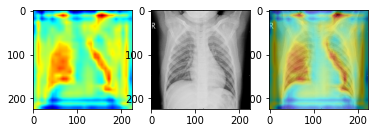

In [ ]:
fig, ax = plt.subplots(1, 3)

ax[0].imshow(heatmap)
ax[1].imshow(image)
ax[2].imshow(output)

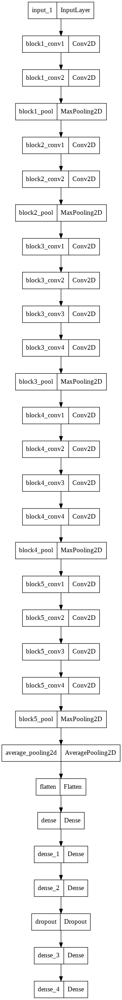

In [ ]:
tf.keras.utils.plot_model(
    model,
    to_file="/model.png",
    show_shapes=False,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=96,
    layer_range=None,
    show_layer_activations=False,
)

In [ ]:
tf.keras.utils.model_to_dot(
    model,
    show_shapes=False,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=96,
    subgraph=False,
    layer_range=None,
    show_layer_activations=False,
)

In [ ]:
%tensorboard --logdir "/logs"

<IPython.core.display.Javascript object>